# Objective

* Use a GAN to create hand-written digits
* Follow the tutorial: https://colab.research.google.com/github/PytorchLightning/pytorch-lightning/blob/master/notebooks/03-basic-gan.ipynb#scrollTo=kg2MKpRmybht

# Setup

In [1]:
import numpy as np
import torch
from torch import nn, optim
import torch.nn.functional as F
from torch.utils.data import DataLoader, random_split
from torchvision import transforms, datasets
from torchvision.utils import make_grid
from torchvision.datasets import MNIST
import pytorch_lightning as pl
from pytorch_lightning import Trainer
from pytorch_lightning.callbacks import Callback
import matplotlib.pyplot as plt

# Dataset

* MNIST

# Data Module

In [2]:
class MNISTDataModule(pl.LightningDataModule):
    def __init__(self, args):
        super().__init__()
        self.batch_size = args['batch_size']
        self.num_workers = args['num_workers']
        self.data_dir = args['data_dir']
        
        self.transform = transforms.Compose([transforms.ToTensor(),
                                             transforms.Normalize((0.1307,), (0.3081,))])

    #def prepare_data(self):
    #    # Download MNIST data
    #    MNIST(self.data_dir, download=True, train=True)
    #    MNIST(self.data_dir, download=True, train=False)
        
    def setup(self, stage):
        # train/val datasets
        if stage == 'fit' or stage is None:
            mnist_train_full = MNIST(self.data_dir, train=True, download=True, transform=self.transform)
            self.mnist_train, self.mnist_val = random_split(mnist_train_full, [55000,5000])
            
        # test dataset
        if stage == 'test' or stage is None:
            self.mnist_test = MNIST(self.data_dir, train=False, download=True, transform=self.transform)
        
    def train_dataloader(self):
        train_dataloader = DataLoader(self.mnist_train, batch_size=self.batch_size, 
                                      shuffle=True, num_workers=self.num_workers)
        print(f'train dataloader: {next(iter(train_dataloader))[0].shape}')
        return train_dataloader
    
    def val_dataloader(self):
        val_dataloader = DataLoader(self.mnist_val, batch_size=self.batch_size, num_workers=self.num_workers)
        return val_dataloader
    
    def test_dataloader(self):
        test_dataloader = DataLoader(self.mnist_test, batch_size=self.batch_size, num_workers=self.num_workers)
        return test_dataloader

# Models

## Generator

In [3]:
class MNISTGenerator(nn.Module):
    def __init__(self, args):
        super().__init__()
        self.im_dim = args['im_dim']
        self.noise_dim = args['noise_dim']
        self.im_shape = args['im_shape']
        
        def gen_block(input_dim, output_dim, normalize=True):
            layers = [nn.Linear(input_dim, output_dim)]
            if normalize:
                layers.append(nn.BatchNorm1d(output_dim, 0.8))
            layers.append(nn.LeakyReLU(negative_slope=0.2, inplace=True))
            return layers
        
        self.gen_model = nn.Sequential(*gen_block(self.noise_dim, 128, normalize=False),
                                       *gen_block(128, 256),
                                       *gen_block(256, 512),
                                       *gen_block(512, 1024),
                                       nn.Linear(1024, self.im_dim), # last linear layer to get size of image
                                       nn.Tanh())
            
    def forward(self, z):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            z: a noise tensor with dimensions (n_samples, z_dim); n_samples flattened images
        '''
        z = self.gen_model(z)
        z = z.view(z.size(0), *self.im_shape)
        return z
        

## Discriminator

In [4]:
class MNISTDiscriminator(nn.Module):
    def __init__(self, args):
        super().__init__()
        im_dim = args['im_dim']
        self.im_shape = args['im_shape']
        
        def disc_block(input_dim, output_dim):
            layers = [nn.Linear(input_dim, output_dim)]
            layers.append(nn.LeakyReLU(negative_slope=0.2, inplace=True))
            return layers
        
        self.disc_model = nn.Sequential(*disc_block(im_dim, 512),
                                        *disc_block(512, 256),
                                        nn.Linear(256, 1))#,
                                        #nn.Sigmoid())
    
    def forward(self, img):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            img: a flattened image tensor with dimension (im_dim)
        '''
        img_flat = img.view(img.size(0), -1)
        output = self.disc_model(img_flat)
        return output

In [5]:
# set parameters
args = {'data_dir': 'data/',
        'batch_size': 64,
        'num_workers': 1,
        'im_dim': 784,
        'im_shape': (1, 28, 28),
        'noise_dim': 100,
        'lr': 1e-3,
        'b1': 0.5,
        'b2': 0.999
         }
print(args)

# nr of images to be constructed
n_samples = 64
# create random noise vector
noise = torch.rand(n_samples, args['noise_dim'])
print(noise.shape)

data_module = MNISTDataModule(args)
gen = MNISTGenerator(args) 
fake = gen(noise)
print('fake shape', fake.shape)
print(gen(noise).shape)

disc = MNISTDiscriminator(args)
print(disc(fake).shape)

{'data_dir': 'data/', 'batch_size': 64, 'num_workers': 1, 'im_dim': 784, 'im_shape': (1, 28, 28), 'noise_dim': 100, 'lr': 0.001, 'b1': 0.5, 'b2': 0.999}
torch.Size([64, 100])
fake shape torch.Size([64, 1, 28, 28])
torch.Size([64, 1, 28, 28])
torch.Size([64, 1])


# GAN

In [6]:
class MNISTGAN(pl.LightningModule):
    def __init__(self, args):
        super().__init__()
        
        self.generator = MNISTGenerator(args)
        self.discriminator = MNISTDiscriminator(args)
        
    def forward(self, z):
        return self.generator(z)
    
    def adversarial_loss(self, y_hat, y):
        #ad_loss = F.binary_cross_entropy(y_hat, y)
        criterion = nn.BCEWithLogitsLoss()
        ad_loss = criterion(y_hat,y )
        return ad_loss
    
    def training_step(self, train_batch, batch_idx, optimizer_idx):
        self.imgs, _ = train_batch
        
        # sample noise
        z = torch.rand(self.imgs.shape[0], args['noise_dim'])
        #z = np.random.uniform(-1, 1, size=(self.imgs.shape[0], args['noise_dim']))
        #z = torch.from_numpy(z).float()
        z = z.type_as(self.imgs) # make sure to initialize new tensors on the right device
        
        # train generator
        if optimizer_idx == 0:
            # generate fake images
            self.generated_imgs = self(z) # apply forward pass
                        
            # ground truth: all fake
            # generator wants the discriminator to think that its fake images are real
            valid = torch.ones(self.imgs.size(0), 1)
            valid = valid.type_as(self.imgs)
                        
            # adversarial loss
            gen_loss = self.adversarial_loss(self.discriminator(self.generated_imgs), valid)
            
            self.log('gen_loss', gen_loss, on_epoch=True)
            return {'loss': gen_loss}
        
        # train discriminator
        if optimizer_idx == 1:
            # Measure discriminator's ability to classify real from generated samples
            
            # how well can it label as real?
            valid = torch.ones(self.imgs.size(0), 1)
            valid = valid.type_as(self.imgs)
            
            # discriminator output on real image
            real_output = self.discriminator(self.imgs)
            
            real_loss = self.adversarial_loss(real_output, valid)
            
            # How well can it label as fake?
            valid = torch.zeros(self.imgs.size(0), 1)
            valid = valid.type_as(self.imgs)
            
            # discriminator output on fake image
            fake_output = self.discriminator(self.generated_imgs.detach())
            fake_loss = self.adversarial_loss(fake_output, valid)
            
            # discrimator loss is the average of the two losses above
            disc_loss = (real_loss + fake_loss) / 2
            
            self.log('disc_loss', disc_loss, on_epoch=True)
            return {'loss': disc_loss}
            
            
    def configure_optimizers(self):
        lr = args['lr'] # learning rate
        b1 = args['b1']
        b2 = args['b2']
        
        opt_gen = torch.optim.Adam(self.generator.parameters(), lr=lr, betas=(b1, b2))
        opt_disc = torch.optim.Adam(self.discriminator.parameters(), lr=lr, betas=(b1,b2))
        return opt_gen, opt_disc #[opt_gen, opt_disc],[]
    
    

# Callbacks

In [7]:
class MNISTCallbacks(Callback):
    def __init__(self):
        super().__init__()
        
    def on_epoch_end(self, trainer, pl_module):
        metrics = trainer.callback_metrics
        epoch = trainer.current_epoch
        print(f'\nEpoch {epoch}:')
        for key, item in metrics.items():
            print(f'{key}: {item:.4f}')
            
        num_images=10
        image_unflat = pl_module.generated_imgs.detach().cpu().view(-1, *args['im_shape'])
        
        image_grid = make_grid(image_unflat[:num_images], nrow=5)
        plt.imshow(image_grid.permute(1, 2, 0).squeeze(), cmap="gray")
        plt.show()
        
        image_grid = make_grid(pl_module.imgs[:num_images], nrow=5)
        plt.imshow(image_grid.permute(1, 2, 0).squeeze(), cmap="gray")
        plt.show()
        

GPU available: False, used: False
TPU available: None, using: 0 TPU cores
/home/frauke/anaconda3/envs/lightning_env/lib/python3.7/site-packages/pytorch_lightning/utilities/distributed.py:49: UserWarning: you passed in a val_dataloader but have no validation_step. Skipping validation loop
  warnings.warn(*args, **kwargs)

  | Name          | Type               | Params
-----------------------------------------------------
0 | generator     | MNISTGenerator     | 1.5 M 
1 | discriminator | MNISTDiscriminator | 533 K 
-----------------------------------------------------
2.0 M     Trainable params
0         Non-trainable params
2.0 M     Total params


train dataloader: torch.Size([64, 1, 28, 28])
Epoch 0:   0%|          | 0/860 [00:00<?, ?it/s] 

/home/frauke/anaconda3/envs/lightning_env/lib/python3.7/site-packages/pytorch_lightning/utilities/distributed.py:49: UserWarning: The dataloader, train dataloader, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 8 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  warnings.warn(*args, **kwargs)


Epoch 0: 100%|██████████| 860/860 [00:55<00:00, 15.52it/s, loss=2.43, v_num=191] 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 0:
disc_loss_step: 0.1287
gen_loss_epoch: 2.5132
disc_loss_epoch: 0.3002
gen_loss: 5.9211
disc_loss: 0.1287


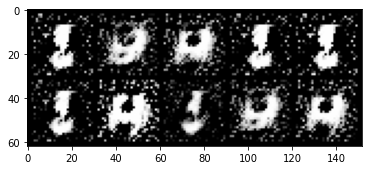

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


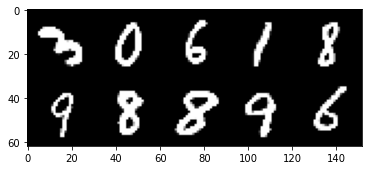

Epoch 1: 100%|██████████| 860/860 [00:53<00:00, 16.09it/s, loss=5.92, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 1:
disc_loss_step: 0.0540
gen_loss_epoch: 4.8864
disc_loss_epoch: 0.1416
gen_loss: 3.5150
disc_loss: 0.0540


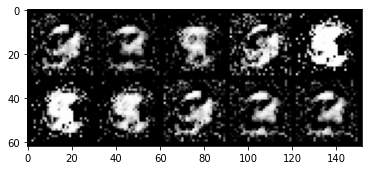

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


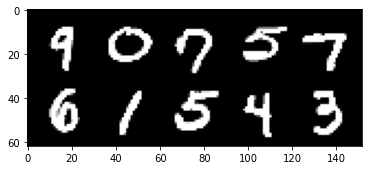

Epoch 2: 100%|██████████| 860/860 [00:43<00:00, 19.63it/s, loss=2.97, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 2:
disc_loss_step: 0.0218
gen_loss_epoch: 6.3105
disc_loss_epoch: 0.0638
gen_loss: 5.8996
disc_loss: 0.0218


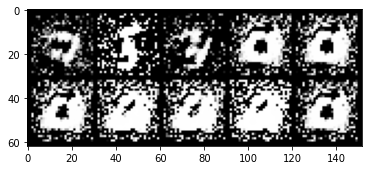

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


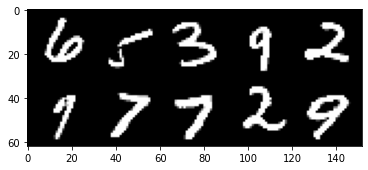

Epoch 3: 100%|██████████| 860/860 [00:42<00:00, 20.05it/s, loss=4.56, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 3:
disc_loss_step: 0.0141
gen_loss_epoch: 8.1007
disc_loss_epoch: 0.0507
gen_loss: 8.5542
disc_loss: 0.0141


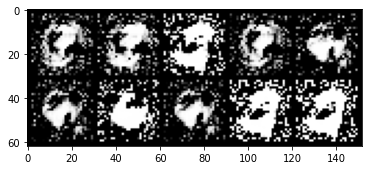

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


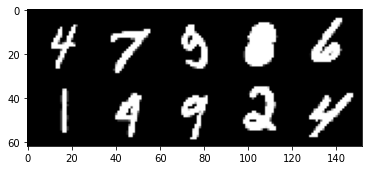

Epoch 4: 100%|██████████| 860/860 [00:55<00:00, 15.61it/s, loss=2.76, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 4:
disc_loss_step: 0.0020
gen_loss_epoch: 8.2410
disc_loss_epoch: 0.0438
gen_loss: 6.1944
disc_loss: 0.0020


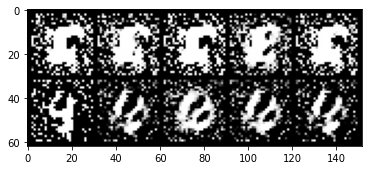

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


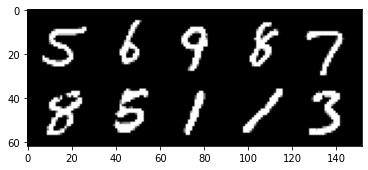

Epoch 5: 100%|██████████| 860/860 [00:41<00:00, 20.79it/s, loss=4.76, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 5:
disc_loss_step: 0.0197
gen_loss_epoch: 8.1075
disc_loss_epoch: 0.0411
gen_loss: 17.0238
disc_loss: 0.0197


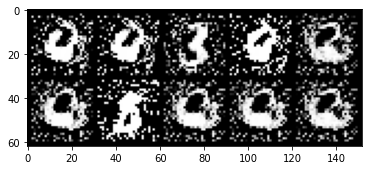

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


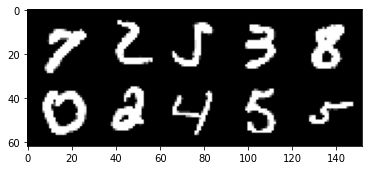

Epoch 6: 100%|██████████| 860/860 [00:45<00:00, 18.94it/s, loss=5.03, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 6:
disc_loss_step: 0.0040
gen_loss_epoch: 7.9248
disc_loss_epoch: 0.0407
gen_loss: 5.9921
disc_loss: 0.0040


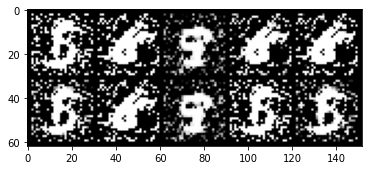

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


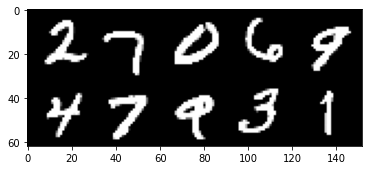

Epoch 7: 100%|██████████| 860/860 [00:46<00:00, 18.43it/s, loss=3, v_num=191]   

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 7:
disc_loss_step: 0.0032
gen_loss_epoch: 8.5585
disc_loss_epoch: 0.0422
gen_loss: 6.3344
disc_loss: 0.0032


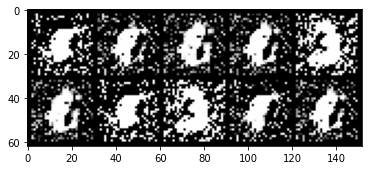

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


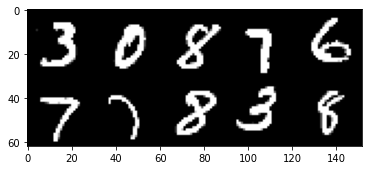

Epoch 8: 100%|██████████| 860/860 [00:48<00:00, 17.65it/s, loss=8.15, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 8:
disc_loss_step: 0.0389
gen_loss_epoch: 8.3400
disc_loss_epoch: 0.0309
gen_loss: 13.9989
disc_loss: 0.0389


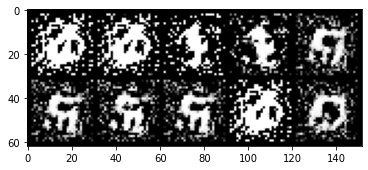

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


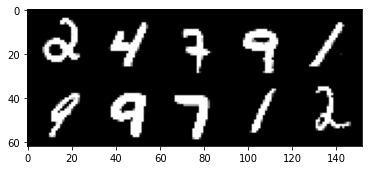

Epoch 9: 100%|██████████| 860/860 [00:47<00:00, 18.02it/s, loss=3.09, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 9:
disc_loss_step: 0.0012
gen_loss_epoch: 8.5693
disc_loss_epoch: 0.0269
gen_loss: 7.5422
disc_loss: 0.0012


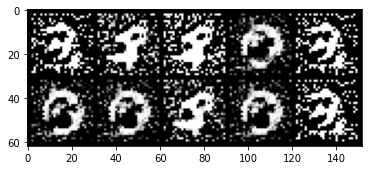

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


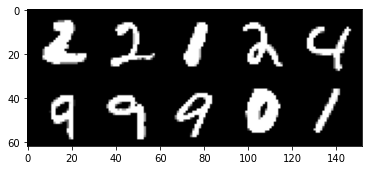

Epoch 10: 100%|██████████| 860/860 [00:44<00:00, 19.23it/s, loss=4.22, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 10:
disc_loss_step: 0.0014
gen_loss_epoch: 8.4883
disc_loss_epoch: 0.0443
gen_loss: 6.3683
disc_loss: 0.0014


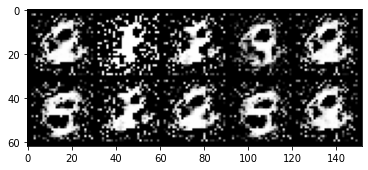

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


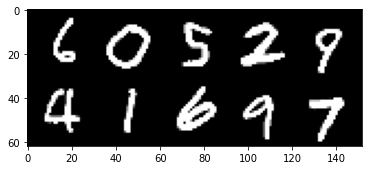

Epoch 11: 100%|██████████| 860/860 [00:42<00:00, 20.07it/s, loss=4.79, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 11:
disc_loss_step: 0.0323
gen_loss_epoch: 8.6907
disc_loss_epoch: 0.0277
gen_loss: 5.6011
disc_loss: 0.0323


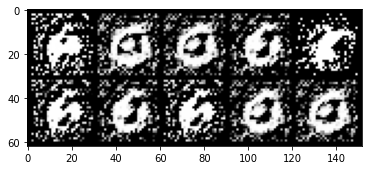

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


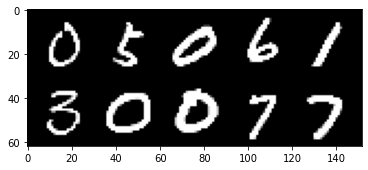

Epoch 12: 100%|██████████| 860/860 [00:42<00:00, 20.13it/s, loss=3.49, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 12:
disc_loss_step: 0.0021
gen_loss_epoch: 9.0784
disc_loss_epoch: 0.0268
gen_loss: 6.8242
disc_loss: 0.0021


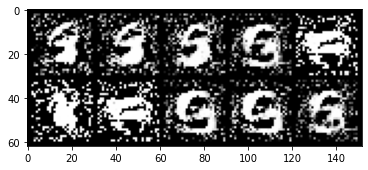

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


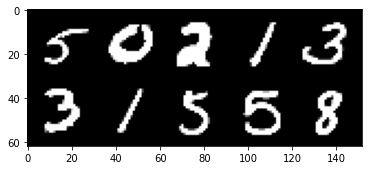

Epoch 13: 100%|██████████| 860/860 [00:50<00:00, 17.05it/s, loss=3.09, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 13:
disc_loss_step: 0.0066
gen_loss_epoch: 9.0360
disc_loss_epoch: 0.0228
gen_loss: 5.8733
disc_loss: 0.0066


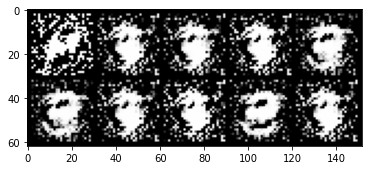

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


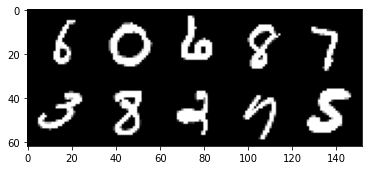

Epoch 14: 100%|██████████| 860/860 [00:44<00:00, 19.49it/s, loss=8.38, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 14:
disc_loss_step: 0.0019
gen_loss_epoch: 9.9846
disc_loss_epoch: 0.0231
gen_loss: 10.4720
disc_loss: 0.0019


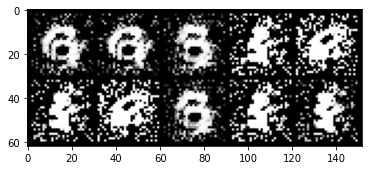

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


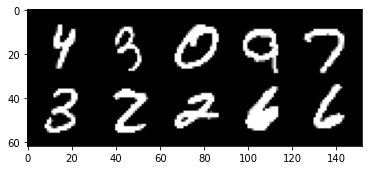

Epoch 15: 100%|██████████| 860/860 [00:48<00:00, 17.80it/s, loss=4.8, v_num=191] 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 15:
disc_loss_step: 0.0007
gen_loss_epoch: 9.4617
disc_loss_epoch: 0.0166
gen_loss: 8.0555
disc_loss: 0.0007


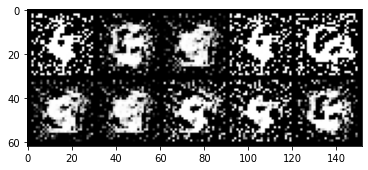

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


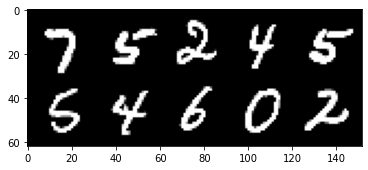

Epoch 16: 100%|██████████| 860/860 [00:44<00:00, 19.46it/s, loss=4.54, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 16:
disc_loss_step: 0.0003
gen_loss_epoch: 10.2416
disc_loss_epoch: 0.0333
gen_loss: 8.5359
disc_loss: 0.0003


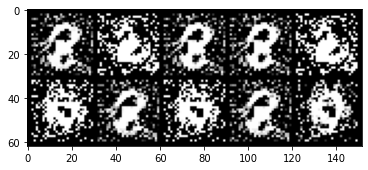

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


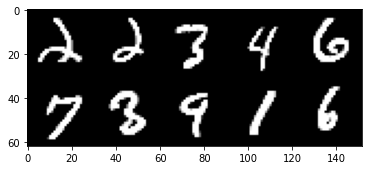

Epoch 17: 100%|██████████| 860/860 [00:46<00:00, 18.40it/s, loss=10.4, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 17:
disc_loss_step: 0.4411
gen_loss_epoch: 8.7690
disc_loss_epoch: 0.0257
gen_loss: 20.3351
disc_loss: 0.4411


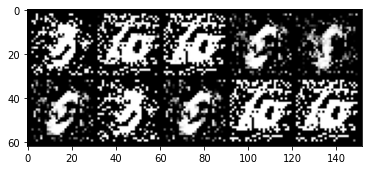

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


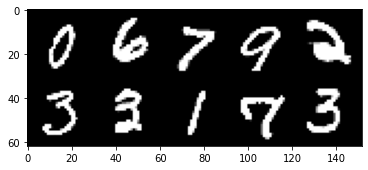

Epoch 18: 100%|██████████| 860/860 [00:45<00:00, 18.77it/s, loss=5.06, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 18:
disc_loss_step: 0.0042
gen_loss_epoch: 8.3762
disc_loss_epoch: 0.0149
gen_loss: 6.4418
disc_loss: 0.0042


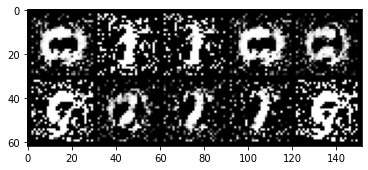

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


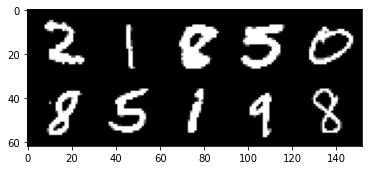

Epoch 19: 100%|██████████| 860/860 [00:44<00:00, 19.53it/s, loss=11.6, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 19:
disc_loss_step: 0.0033
gen_loss_epoch: 10.0537
disc_loss_epoch: 0.0127
gen_loss: 10.9899
disc_loss: 0.0033


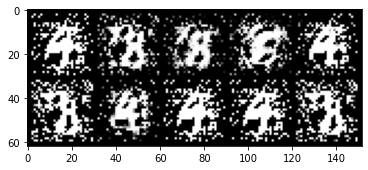

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


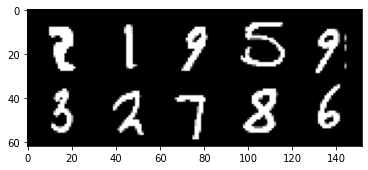

Epoch 20: 100%|██████████| 860/860 [00:41<00:00, 20.53it/s, loss=3.35, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 20:
disc_loss_step: 0.0016
gen_loss_epoch: 9.2690
disc_loss_epoch: 0.0460
gen_loss: 7.0082
disc_loss: 0.0016


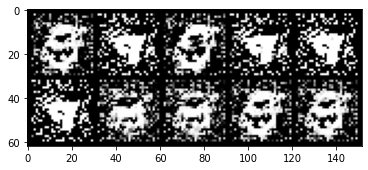

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


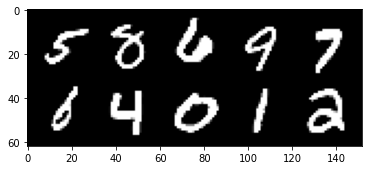

Epoch 21: 100%|██████████| 860/860 [00:47<00:00, 18.29it/s, loss=4.76, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 21:
disc_loss_step: 0.0001
gen_loss_epoch: 8.8846
disc_loss_epoch: 0.0105
gen_loss: 11.0889
disc_loss: 0.0001


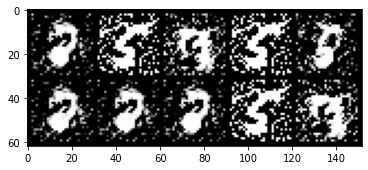

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


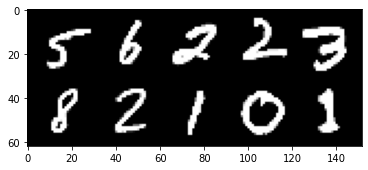

Epoch 22: 100%|██████████| 860/860 [00:42<00:00, 20.17it/s, loss=3.23, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 22:
disc_loss_step: 0.0072
gen_loss_epoch: 9.4931
disc_loss_epoch: 0.0306
gen_loss: 5.8858
disc_loss: 0.0072


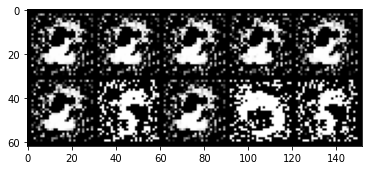

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


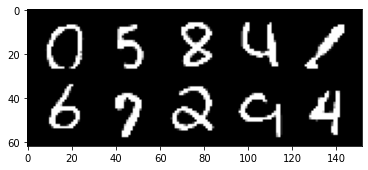

Epoch 23: 100%|██████████| 860/860 [00:43<00:00, 19.69it/s, loss=3.83, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 23:
disc_loss_step: 0.0076
gen_loss_epoch: 9.5203
disc_loss_epoch: 0.0107
gen_loss: 7.4078
disc_loss: 0.0076


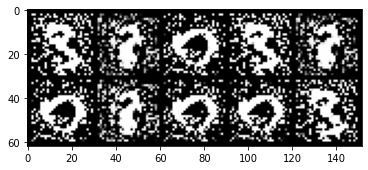

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


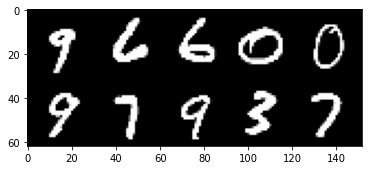

Epoch 24: 100%|██████████| 860/860 [00:44<00:00, 19.15it/s, loss=5.12, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 24:
disc_loss_step: 0.0461
gen_loss_epoch: 12.1618
disc_loss_epoch: 0.0282
gen_loss: 11.1427
disc_loss: 0.0461


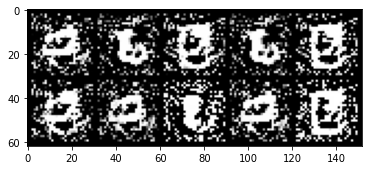

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


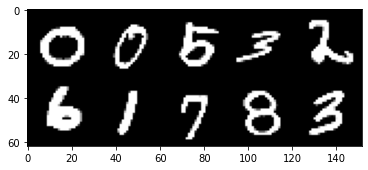

Epoch 25: 100%|██████████| 860/860 [00:47<00:00, 18.00it/s, loss=5.15, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 25:
disc_loss_step: 0.0002
gen_loss_epoch: 8.8969
disc_loss_epoch: 0.0095
gen_loss: 10.7089
disc_loss: 0.0002


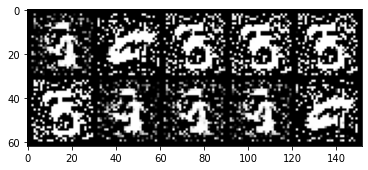

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


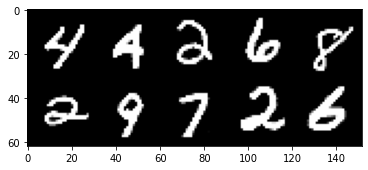

Epoch 26: 100%|██████████| 860/860 [00:48<00:00, 17.87it/s, loss=3.78, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 26:
disc_loss_step: 0.0006
gen_loss_epoch: 11.7638
disc_loss_epoch: 0.0231
gen_loss: 7.9202
disc_loss: 0.0006


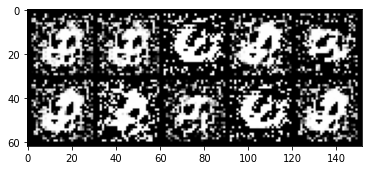

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


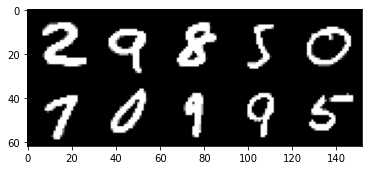

Epoch 27: 100%|██████████| 860/860 [00:44<00:00, 19.19it/s, loss=4.77, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 27:
disc_loss_step: 0.0036
gen_loss_epoch: 9.8031
disc_loss_epoch: 0.0093
gen_loss: 6.1974
disc_loss: 0.0036


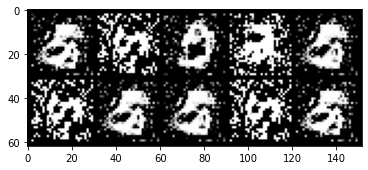

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


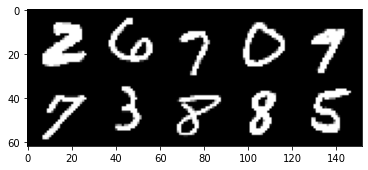

Epoch 28: 100%|██████████| 860/860 [00:43<00:00, 19.98it/s, loss=4.82, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 28:
disc_loss_step: 0.0004
gen_loss_epoch: 12.2243
disc_loss_epoch: 0.0337
gen_loss: 9.1259
disc_loss: 0.0004


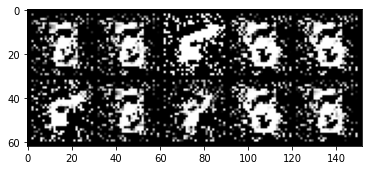

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


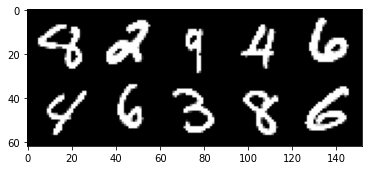

Epoch 29: 100%|██████████| 860/860 [00:43<00:00, 19.94it/s, loss=5.33, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 29:
disc_loss_step: 0.0007
gen_loss_epoch: 8.7467
disc_loss_epoch: 0.0135
gen_loss: 9.3627
disc_loss: 0.0007


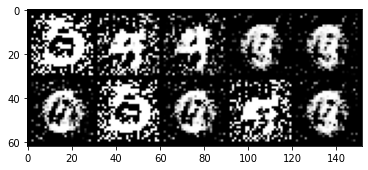

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


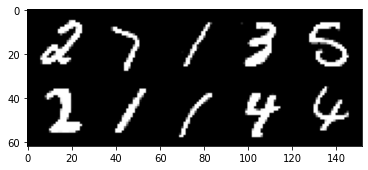

Epoch 30: 100%|██████████| 860/860 [00:42<00:00, 20.06it/s, loss=7.57, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 30:
disc_loss_step: 0.0016
gen_loss_epoch: 12.0817
disc_loss_epoch: 0.0280
gen_loss: 11.1665
disc_loss: 0.0016


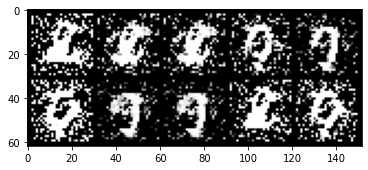

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


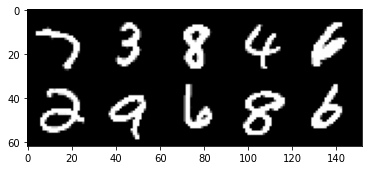

Epoch 31: 100%|██████████| 860/860 [00:45<00:00, 18.89it/s, loss=4.7, v_num=191] 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 31:
disc_loss_step: 0.0050
gen_loss_epoch: 9.0173
disc_loss_epoch: 0.0100
gen_loss: 7.5752
disc_loss: 0.0050


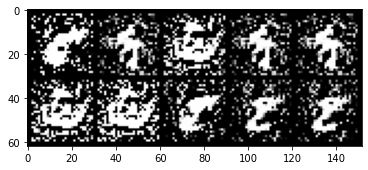

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


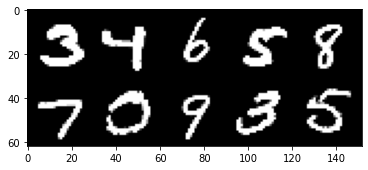

Epoch 32: 100%|██████████| 860/860 [00:45<00:00, 19.09it/s, loss=6.73, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 32:
disc_loss_step: 0.0019
gen_loss_epoch: 10.8824
disc_loss_epoch: 0.0090
gen_loss: 9.2533
disc_loss: 0.0019


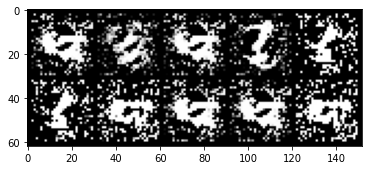

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


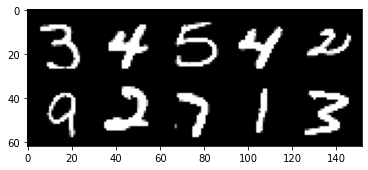

Epoch 33: 100%|██████████| 860/860 [00:45<00:00, 19.06it/s, loss=5.39, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 33:
disc_loss_step: 0.0021
gen_loss_epoch: 15.2224
disc_loss_epoch: 0.0144
gen_loss: 10.9181
disc_loss: 0.0021


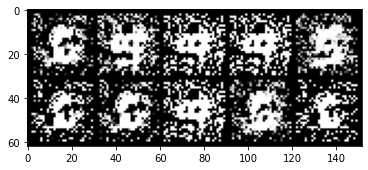

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


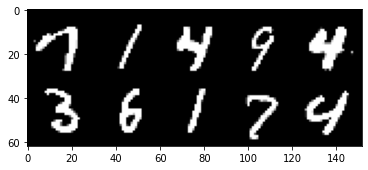

Epoch 34: 100%|██████████| 860/860 [00:50<00:00, 17.10it/s, loss=6.28, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 34:
disc_loss_step: 0.0007
gen_loss_epoch: 12.8299
disc_loss_epoch: 0.0121
gen_loss: 10.9815
disc_loss: 0.0007


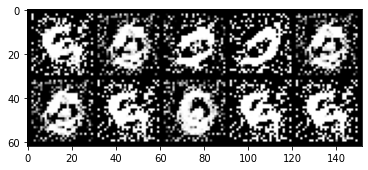

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


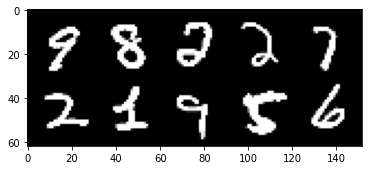

Epoch 35: 100%|██████████| 860/860 [00:49<00:00, 17.41it/s, loss=3.48, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 35:
disc_loss_step: 0.0008
gen_loss_epoch: 12.4123
disc_loss_epoch: 0.0167
gen_loss: 7.1826
disc_loss: 0.0008


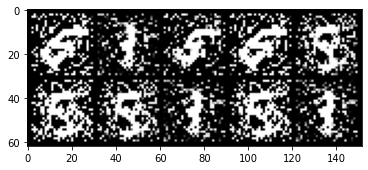

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


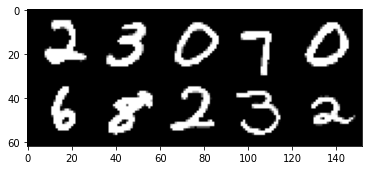

Epoch 36: 100%|██████████| 860/860 [00:45<00:00, 18.76it/s, loss=4.48, v_num=191]
Epoch 36:
disc_loss_step: 0.0006
gen_loss_epoch: 11.0716
disc_loss_epoch: 0.0126
gen_loss: 9.1794
disc_loss: 0.0006


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


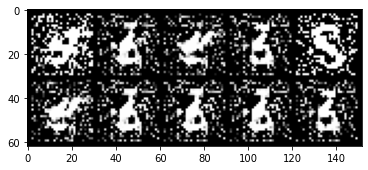

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


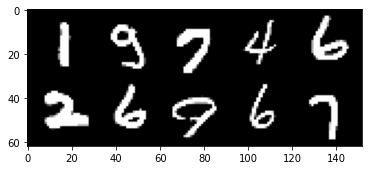

Epoch 37: 100%|██████████| 860/860 [00:43<00:00, 19.98it/s, loss=12.2, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 37:
disc_loss_step: 0.0001
gen_loss_epoch: 12.8344
disc_loss_epoch: 0.0129
gen_loss: 12.8412
disc_loss: 0.0001


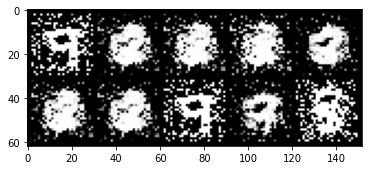

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


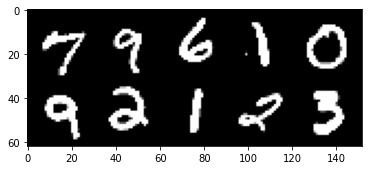

Epoch 38: 100%|██████████| 860/860 [00:43<00:00, 19.68it/s, loss=6.57, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 38:
disc_loss_step: 0.0086
gen_loss_epoch: 12.5965
disc_loss_epoch: 0.0106
gen_loss: 8.0449
disc_loss: 0.0086


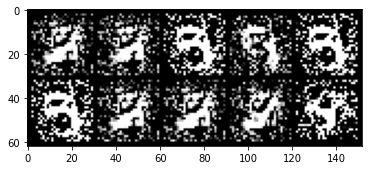

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


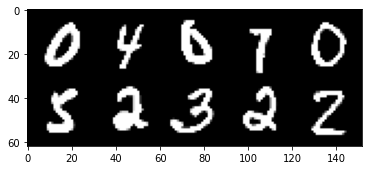

Epoch 39: 100%|██████████| 860/860 [00:44<00:00, 19.41it/s, loss=3.51, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 39:
disc_loss_step: 0.0016
gen_loss_epoch: 13.1069
disc_loss_epoch: 0.0301
gen_loss: 7.7392
disc_loss: 0.0016


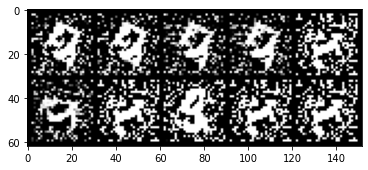

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


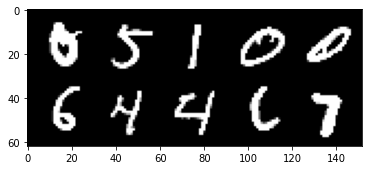

Epoch 40: 100%|██████████| 860/860 [00:44<00:00, 19.50it/s, loss=4.52, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 40:
disc_loss_step: 0.0021
gen_loss_epoch: 9.8374
disc_loss_epoch: 0.0112
gen_loss: 6.4001
disc_loss: 0.0021


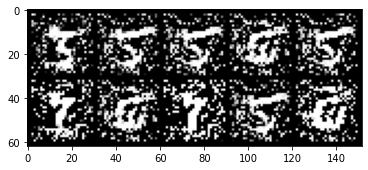

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


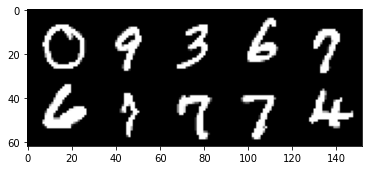

Epoch 41: 100%|██████████| 860/860 [00:44<00:00, 19.51it/s, loss=3.75, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 41:
disc_loss_step: 0.0017
gen_loss_epoch: 10.3758
disc_loss_epoch: 0.0070
gen_loss: 7.3033
disc_loss: 0.0017


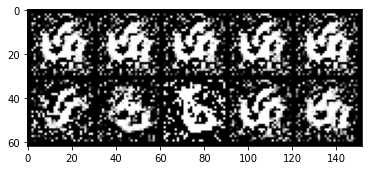

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


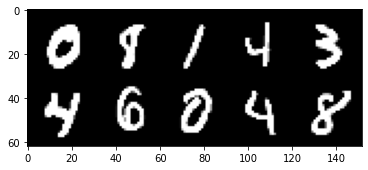

Epoch 42: 100%|██████████| 860/860 [00:40<00:00, 21.06it/s, loss=8.25, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 42:
disc_loss_step: 0.0000
gen_loss_epoch: 12.8264
disc_loss_epoch: 0.0074
gen_loss: 15.7126
disc_loss: 0.0000


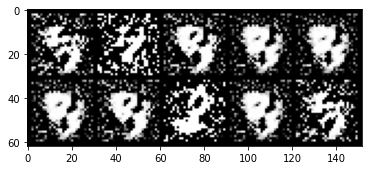

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


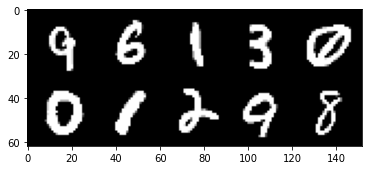

Epoch 43: 100%|██████████| 860/860 [00:43<00:00, 19.86it/s, loss=9.33, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 43:
disc_loss_step: 0.2108
gen_loss_epoch: 15.5489
disc_loss_epoch: 0.0249
gen_loss: 28.5762
disc_loss: 0.2108


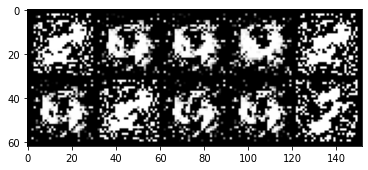

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


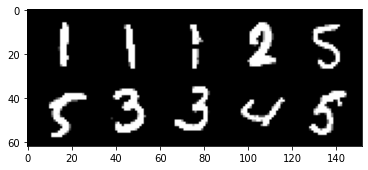

Epoch 44: 100%|██████████| 860/860 [00:44<00:00, 19.14it/s, loss=4.95, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 44:
disc_loss_step: 0.0002
gen_loss_epoch: 11.4174
disc_loss_epoch: 0.0110
gen_loss: 10.9361
disc_loss: 0.0002


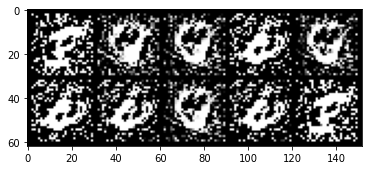

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


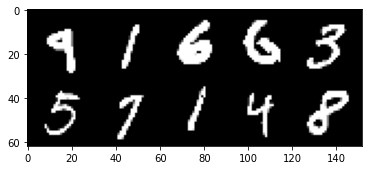

Epoch 45: 100%|██████████| 860/860 [00:44<00:00, 19.15it/s, loss=4.71, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 45:
disc_loss_step: 0.0003
gen_loss_epoch: 11.0463
disc_loss_epoch: 0.0080
gen_loss: 9.3935
disc_loss: 0.0003


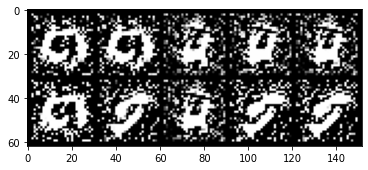

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


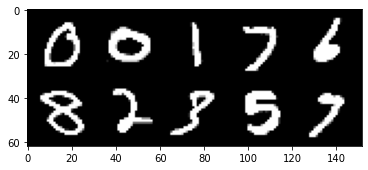

Epoch 46: 100%|██████████| 860/860 [00:41<00:00, 20.76it/s, loss=8.29, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 46:
disc_loss_step: 0.0179
gen_loss_epoch: 12.3252
disc_loss_epoch: 0.0113
gen_loss: 16.4419
disc_loss: 0.0179


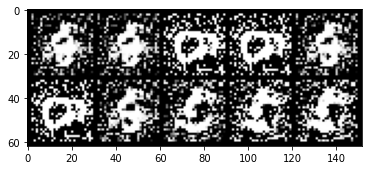

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


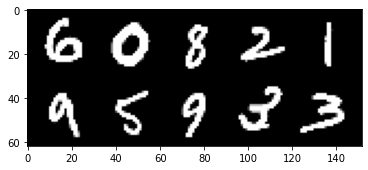

Epoch 47: 100%|██████████| 860/860 [00:44<00:00, 19.33it/s, loss=3.84, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 47:
disc_loss_step: 0.0002
gen_loss_epoch: 14.2758
disc_loss_epoch: 0.0130
gen_loss: 8.6396
disc_loss: 0.0002


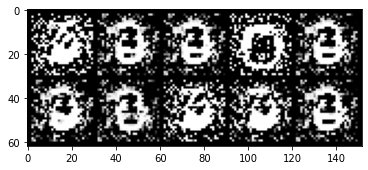

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


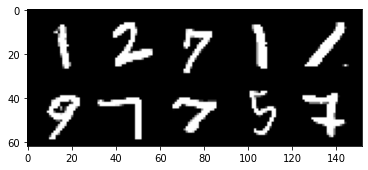

Epoch 48: 100%|██████████| 860/860 [00:43<00:00, 19.85it/s, loss=5.18, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 48:
disc_loss_step: 0.0007
gen_loss_epoch: 11.7554
disc_loss_epoch: 0.0118
gen_loss: 9.6027
disc_loss: 0.0007


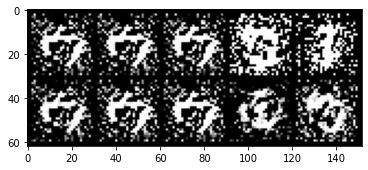

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


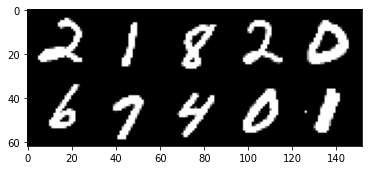

Epoch 49: 100%|██████████| 860/860 [00:40<00:00, 21.18it/s, loss=14.3, v_num=191]
Epoch 49:
disc_loss_step: 0.0702
gen_loss_epoch: 10.5724
disc_loss_epoch: 0.0051
gen_loss: 19.3247
disc_loss: 0.0702


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


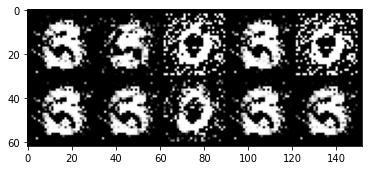

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


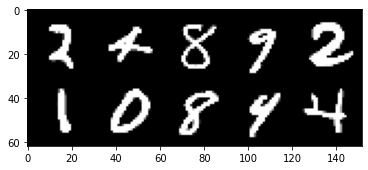

Epoch 50: 100%|██████████| 860/860 [00:49<00:00, 17.46it/s, loss=4.04, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 50:
disc_loss_step: 0.0009
gen_loss_epoch: 15.9487
disc_loss_epoch: 0.0155
gen_loss: 8.4054
disc_loss: 0.0009


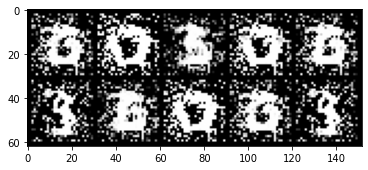

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


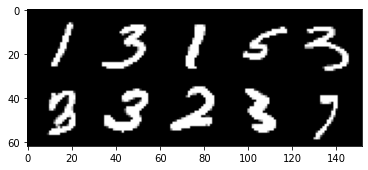

Epoch 51: 100%|██████████| 860/860 [00:48<00:00, 17.56it/s, loss=3.48, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 51:
disc_loss_step: 0.0012
gen_loss_epoch: 12.1474
disc_loss_epoch: 0.0141
gen_loss: 7.1541
disc_loss: 0.0012


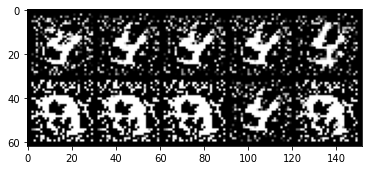

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


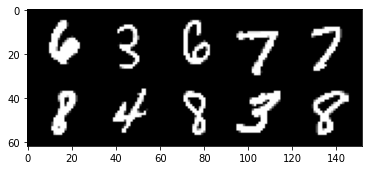

Epoch 52: 100%|██████████| 860/860 [00:45<00:00, 18.91it/s, loss=3.76, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 52:
disc_loss_step: 0.0040
gen_loss_epoch: 10.4160
disc_loss_epoch: 0.0107
gen_loss: 6.1752
disc_loss: 0.0040


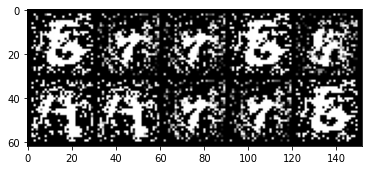

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


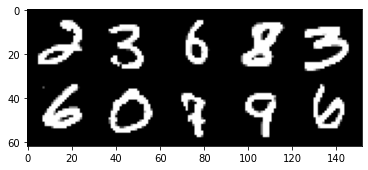

Epoch 53: 100%|██████████| 860/860 [00:44<00:00, 19.28it/s, loss=4.71, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 53:
disc_loss_step: 0.0005
gen_loss_epoch: 12.6642
disc_loss_epoch: 0.0070
gen_loss: 9.0420
disc_loss: 0.0005


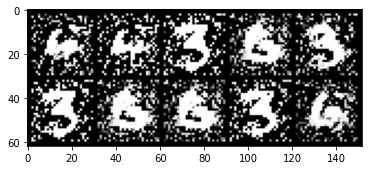

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


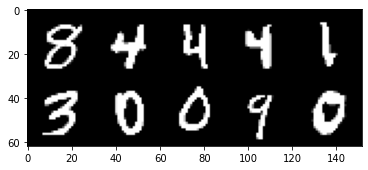

Epoch 54: 100%|██████████| 860/860 [00:41<00:00, 20.68it/s, loss=9.71, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 54:
disc_loss_step: 0.0000
gen_loss_epoch: 16.1771
disc_loss_epoch: 0.0251
gen_loss: 42.3873
disc_loss: 0.0000


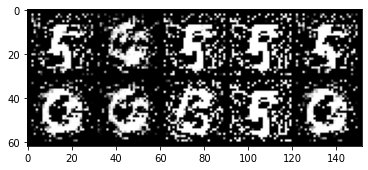

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


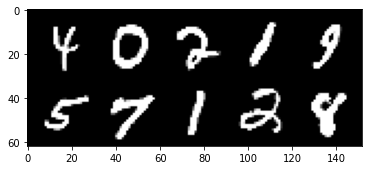

Epoch 55: 100%|██████████| 860/860 [00:40<00:00, 21.06it/s, loss=4.13, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 55:
disc_loss_step: 0.0002
gen_loss_epoch: 10.3884
disc_loss_epoch: 0.0071
gen_loss: 8.5209
disc_loss: 0.0002


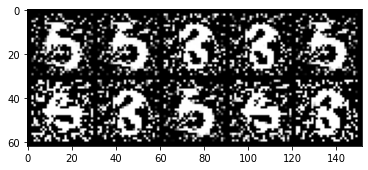

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


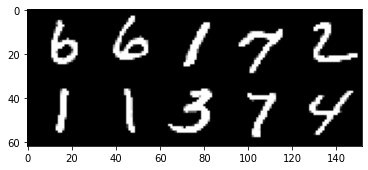

Epoch 56: 100%|██████████| 860/860 [00:44<00:00, 19.44it/s, loss=14.9, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 56:
disc_loss_step: 0.0000
gen_loss_epoch: 15.0990
disc_loss_epoch: 0.0215
gen_loss: 24.3212
disc_loss: 0.0000


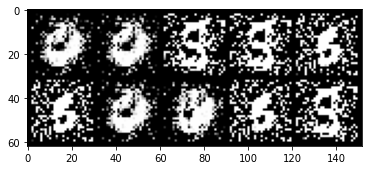

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


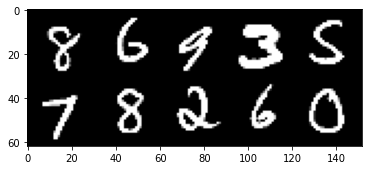

Epoch 57: 100%|██████████| 860/860 [00:44<00:00, 19.16it/s, loss=4.12, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 57:
disc_loss_step: 0.0002
gen_loss_epoch: 12.9604
disc_loss_epoch: 0.0116
gen_loss: 9.1797
disc_loss: 0.0002


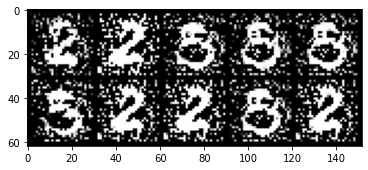

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


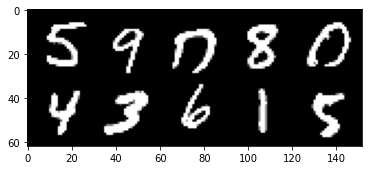

Epoch 58: 100%|██████████| 860/860 [00:45<00:00, 18.82it/s, loss=6.64, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 58:
disc_loss_step: 0.0001
gen_loss_epoch: 11.4961
disc_loss_epoch: 0.0059
gen_loss: 13.3994
disc_loss: 0.0001


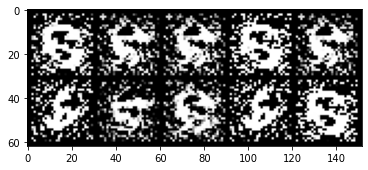

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


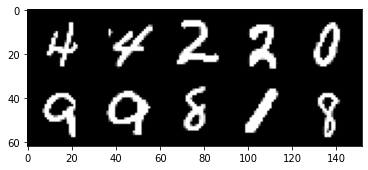

Epoch 59: 100%|██████████| 860/860 [00:51<00:00, 16.76it/s, loss=8.87, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 59:
disc_loss_step: 0.0132
gen_loss_epoch: 17.6607
disc_loss_epoch: 0.0192
gen_loss: 18.2533
disc_loss: 0.0132


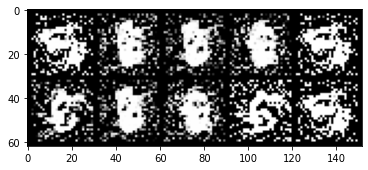

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


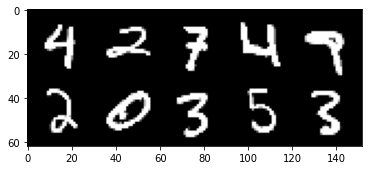

Epoch 60: 100%|██████████| 860/860 [00:50<00:00, 17.16it/s, loss=4.3, v_num=191] 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 60:
disc_loss_step: 0.0004
gen_loss_epoch: 10.6963
disc_loss_epoch: 0.0084
gen_loss: 8.8643
disc_loss: 0.0004


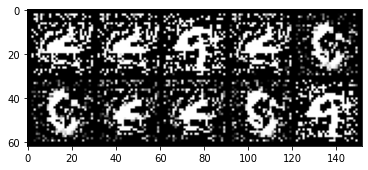

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


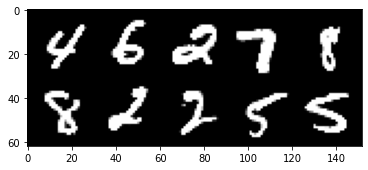

Epoch 61: 100%|██████████| 860/860 [00:51<00:00, 16.61it/s, loss=4.46, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 61:
disc_loss_step: 0.0001
gen_loss_epoch: 11.7704
disc_loss_epoch: 0.0044
gen_loss: 10.7052
disc_loss: 0.0001


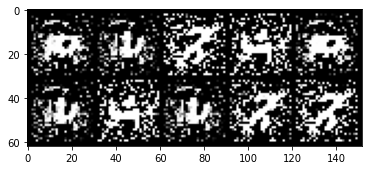

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


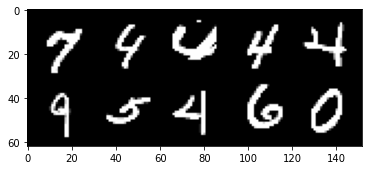

Epoch 62: 100%|██████████| 860/860 [00:47<00:00, 18.29it/s, loss=5.2, v_num=191] 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 62:
disc_loss_step: 0.0017
gen_loss_epoch: 15.0707
disc_loss_epoch: 0.0086
gen_loss: 11.7198
disc_loss: 0.0017


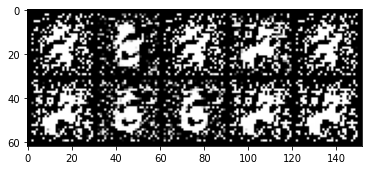

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


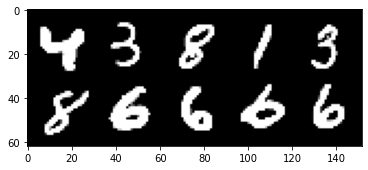

Epoch 63: 100%|██████████| 860/860 [00:57<00:00, 14.83it/s, loss=8.09, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 63:
disc_loss_step: 0.0001
gen_loss_epoch: 15.9416
disc_loss_epoch: 0.0086
gen_loss: 13.8460
disc_loss: 0.0001


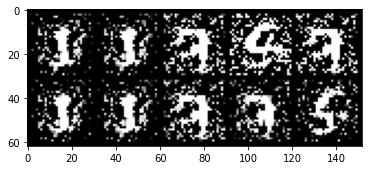

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


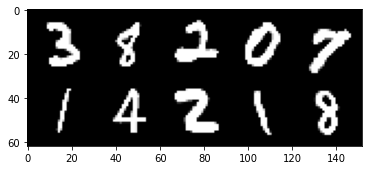

Epoch 64: 100%|██████████| 860/860 [00:51<00:00, 16.77it/s, loss=15.3, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 64:
disc_loss_step: 0.0000
gen_loss_epoch: 15.8369
disc_loss_epoch: 0.0248
gen_loss: 18.4393
disc_loss: 0.0000


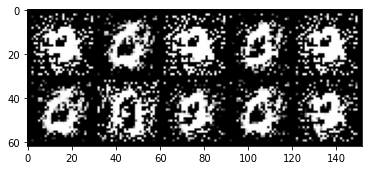

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


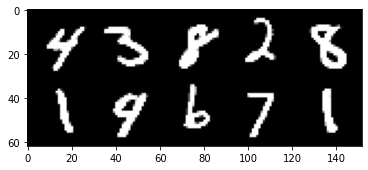

Epoch 65: 100%|██████████| 860/860 [00:44<00:00, 19.24it/s, loss=4.32, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 65:
disc_loss_step: 0.0005
gen_loss_epoch: 10.6123
disc_loss_epoch: 0.0057
gen_loss: 8.5279
disc_loss: 0.0005


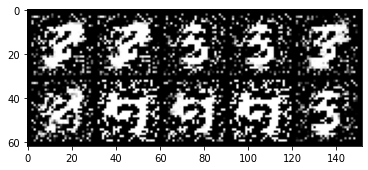

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


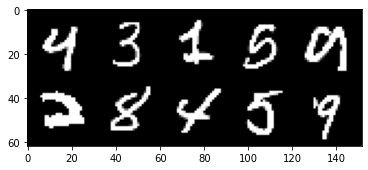

Epoch 66: 100%|██████████| 860/860 [00:43<00:00, 19.71it/s, loss=4.67, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 66:
disc_loss_step: 0.0007
gen_loss_epoch: 14.4496
disc_loss_epoch: 0.0110
gen_loss: 8.9468
disc_loss: 0.0007


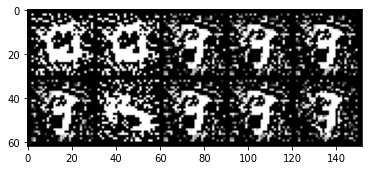

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


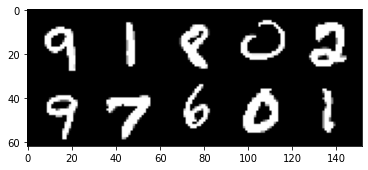

Epoch 67: 100%|██████████| 860/860 [00:42<00:00, 20.17it/s, loss=5.45, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 67:
disc_loss_step: 0.0001
gen_loss_epoch: 11.7608
disc_loss_epoch: 0.0051
gen_loss: 14.4709
disc_loss: 0.0001


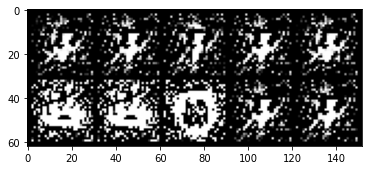

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


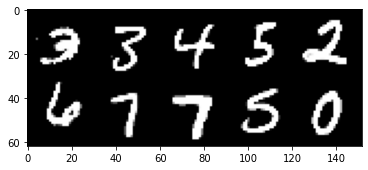

Epoch 68: 100%|██████████| 860/860 [00:43<00:00, 19.57it/s, loss=10, v_num=191]  
Epoch 68:
disc_loss_step: 0.0006
gen_loss_epoch: 15.5770
disc_loss_epoch: 0.0150
gen_loss: 20.1125
disc_loss: 0.0006


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


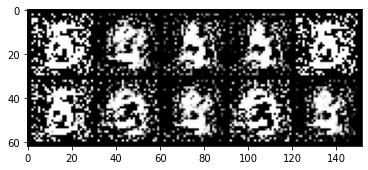

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


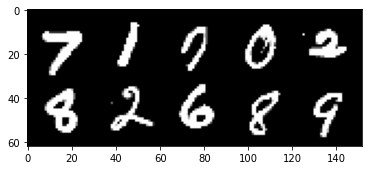

Epoch 69: 100%|██████████| 860/860 [00:49<00:00, 17.55it/s, loss=4.23, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 69:
disc_loss_step: 0.0007
gen_loss_epoch: 12.9640
disc_loss_epoch: 0.0150
gen_loss: 7.4685
disc_loss: 0.0007


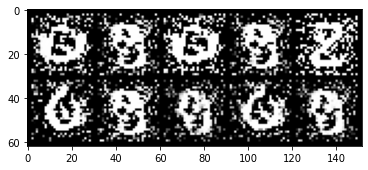

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


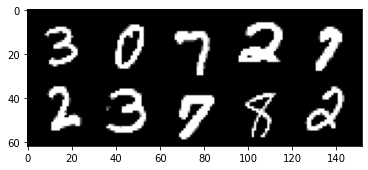

Epoch 70: 100%|██████████| 860/860 [00:48<00:00, 17.83it/s, loss=8.35, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 70:
disc_loss_step: 0.0001
gen_loss_epoch: 12.6199
disc_loss_epoch: 0.0057
gen_loss: 19.1180
disc_loss: 0.0001


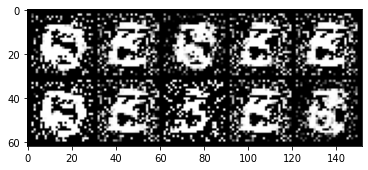

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


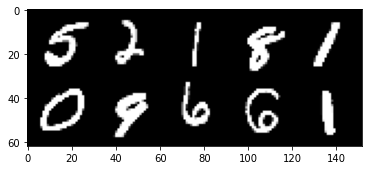

Epoch 71: 100%|██████████| 860/860 [00:46<00:00, 18.61it/s, loss=13.4, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 71:
disc_loss_step: 0.0001
gen_loss_epoch: 16.3075
disc_loss_epoch: 0.0140
gen_loss: 15.7046
disc_loss: 0.0001


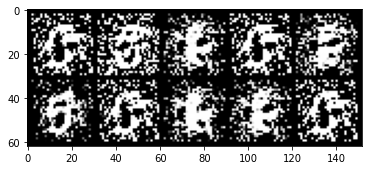

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


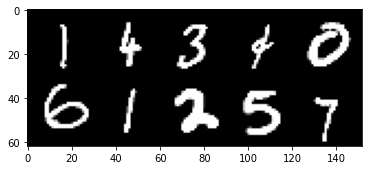

Epoch 72: 100%|██████████| 860/860 [00:47<00:00, 18.16it/s, loss=5.25, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 72:
disc_loss_step: 0.0611
gen_loss_epoch: 16.6550
disc_loss_epoch: 0.0132
gen_loss: 9.8338
disc_loss: 0.0611


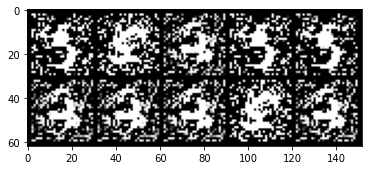

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


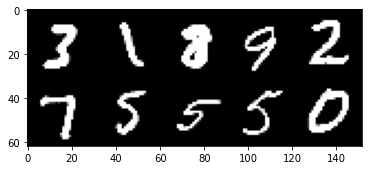

Epoch 73: 100%|██████████| 860/860 [00:45<00:00, 18.82it/s, loss=5.44, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 73:
disc_loss_step: 0.1074
gen_loss_epoch: 14.2182
disc_loss_epoch: 0.0177
gen_loss: 21.2068
disc_loss: 0.1074


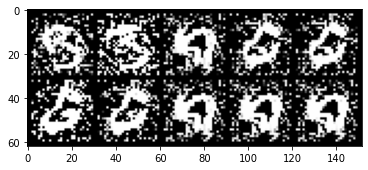

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


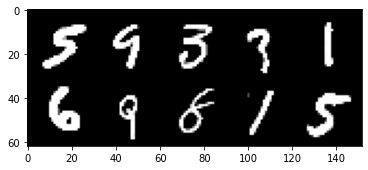

Epoch 74: 100%|██████████| 860/860 [00:45<00:00, 18.86it/s, loss=6.49, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 74:
disc_loss_step: 0.0002
gen_loss_epoch: 10.1237
disc_loss_epoch: 0.0033
gen_loss: 12.7385
disc_loss: 0.0002


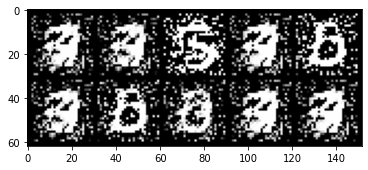

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


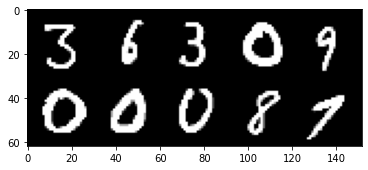

Epoch 75: 100%|██████████| 860/860 [00:44<00:00, 19.27it/s, loss=4.6, v_num=191] 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 75:
disc_loss_step: 0.0005
gen_loss_epoch: 15.7747
disc_loss_epoch: 0.0170
gen_loss: 7.8253
disc_loss: 0.0005


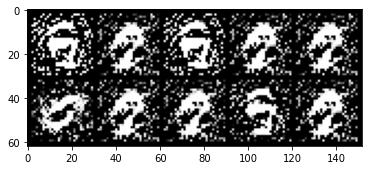

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


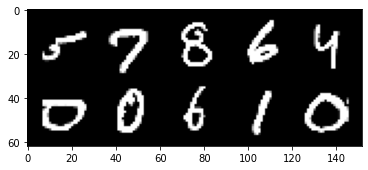

Epoch 76: 100%|██████████| 860/860 [00:47<00:00, 17.93it/s, loss=11, v_num=191]  

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 76:
disc_loss_step: 0.0003
gen_loss_epoch: 13.7085
disc_loss_epoch: 0.0089
gen_loss: 17.5776
disc_loss: 0.0003


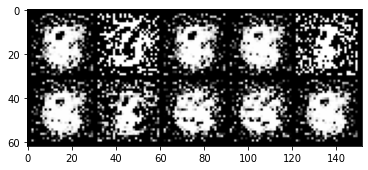

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


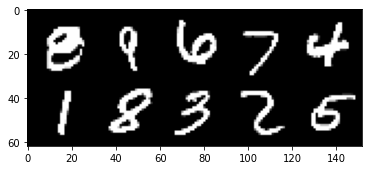

Epoch 77: 100%|██████████| 860/860 [00:44<00:00, 19.45it/s, loss=4.37, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 77:
disc_loss_step: 0.0001
gen_loss_epoch: 15.5116
disc_loss_epoch: 0.0137
gen_loss: 9.5738
disc_loss: 0.0001


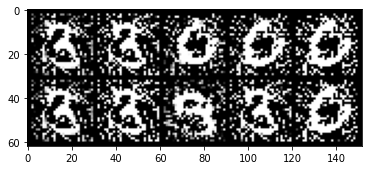

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


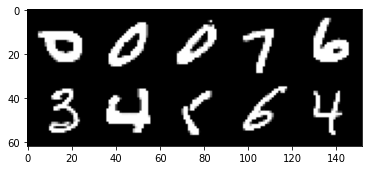

Epoch 78: 100%|██████████| 860/860 [00:55<00:00, 15.58it/s, loss=5.61, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 78:
disc_loss_step: 0.0003
gen_loss_epoch: 11.5861
disc_loss_epoch: 0.0029
gen_loss: 9.9320
disc_loss: 0.0003


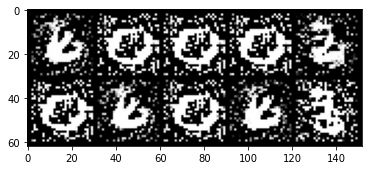

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


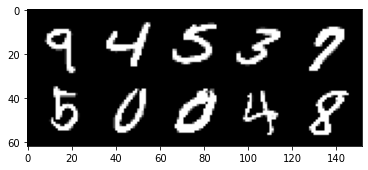

Epoch 79: 100%|██████████| 860/860 [00:57<00:00, 14.99it/s, loss=3.79, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 79:
disc_loss_step: 0.0014
gen_loss_epoch: 15.7527
disc_loss_epoch: 0.0543
gen_loss: 7.0362
disc_loss: 0.0014


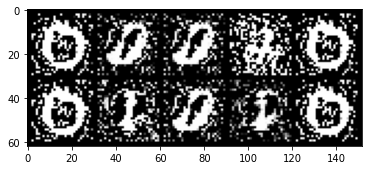

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


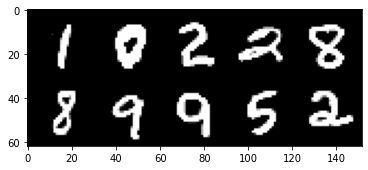

Epoch 80: 100%|██████████| 860/860 [00:48<00:00, 17.87it/s, loss=4.49, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 80:
disc_loss_step: 0.0002
gen_loss_epoch: 8.5222
disc_loss_epoch: 0.0058
gen_loss: 9.9712
disc_loss: 0.0002


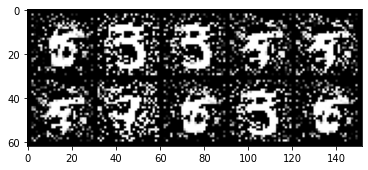

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


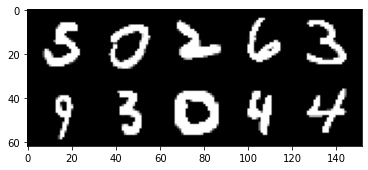

Epoch 81: 100%|██████████| 860/860 [00:43<00:00, 19.79it/s, loss=6.98, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 81:
disc_loss_step: 0.0001
gen_loss_epoch: 14.1073
disc_loss_epoch: 0.0165
gen_loss: 20.7556
disc_loss: 0.0001


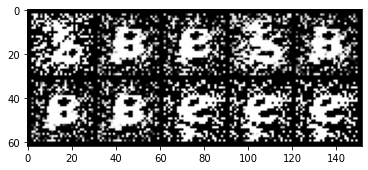

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


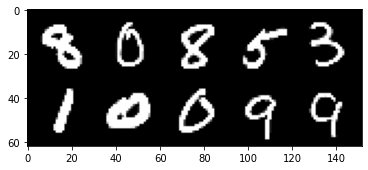

Epoch 82: 100%|██████████| 860/860 [00:44<00:00, 19.28it/s, loss=7.29, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 82:
disc_loss_step: 0.0003
gen_loss_epoch: 10.7532
disc_loss_epoch: 0.0051
gen_loss: 21.9171
disc_loss: 0.0003


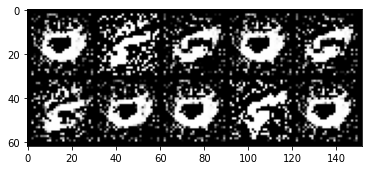

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


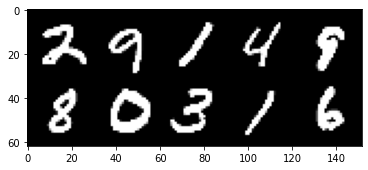

Epoch 83: 100%|██████████| 860/860 [00:46<00:00, 18.30it/s, loss=6.93, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 83:
disc_loss_step: 0.0000
gen_loss_epoch: 12.1784
disc_loss_epoch: 0.0052
gen_loss: 19.3537
disc_loss: 0.0000


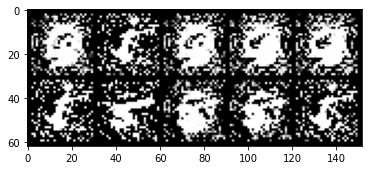

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


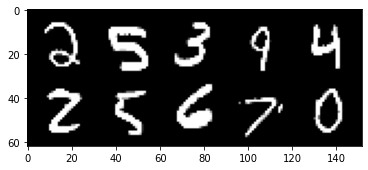

Epoch 84: 100%|██████████| 860/860 [00:47<00:00, 18.26it/s, loss=5.89, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 84:
disc_loss_step: 0.0003
gen_loss_epoch: 17.1024
disc_loss_epoch: 0.0090
gen_loss: 10.9537
disc_loss: 0.0003


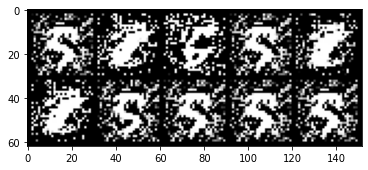

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


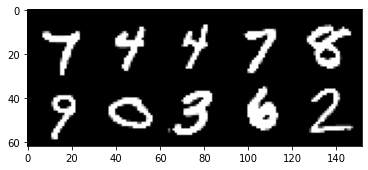

Epoch 85: 100%|██████████| 860/860 [00:48<00:00, 17.85it/s, loss=6.69, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 85:
disc_loss_step: 0.0309
gen_loss_epoch: 18.7248
disc_loss_epoch: 0.0362
gen_loss: 9.5001
disc_loss: 0.0309


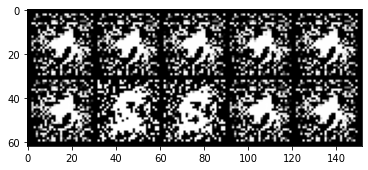

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


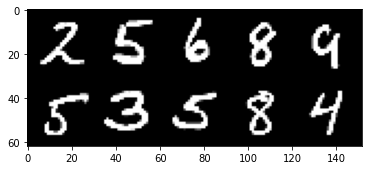

Epoch 86: 100%|██████████| 860/860 [00:51<00:00, 16.66it/s, loss=4.52, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 86:
disc_loss_step: 0.0009
gen_loss_epoch: 17.1896
disc_loss_epoch: 0.0176
gen_loss: 7.5576
disc_loss: 0.0009


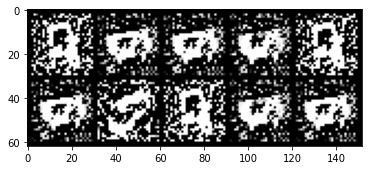

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


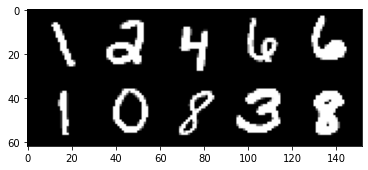

Epoch 87: 100%|██████████| 860/860 [00:42<00:00, 20.02it/s, loss=4.5, v_num=191] 
Epoch 87:


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


disc_loss_step: 0.0021
gen_loss_epoch: 9.5854
disc_loss_epoch: 0.0046
gen_loss: 7.7287
disc_loss: 0.0021


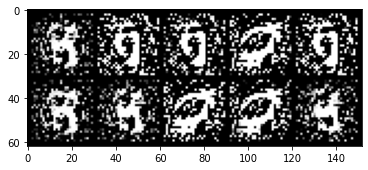

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


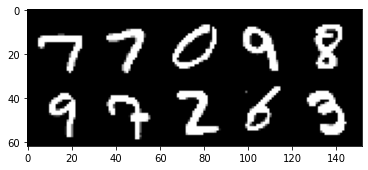

Epoch 88: 100%|██████████| 860/860 [00:43<00:00, 19.56it/s, loss=8.69, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 88:
disc_loss_step: 0.0008
gen_loss_epoch: 12.8722
disc_loss_epoch: 0.0065
gen_loss: 14.6024
disc_loss: 0.0008


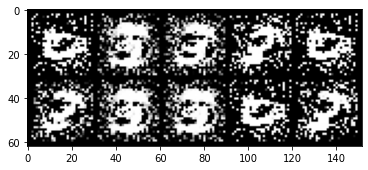

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


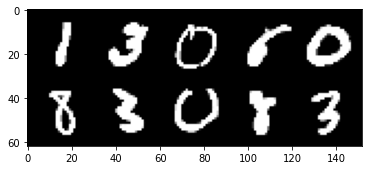

Epoch 89: 100%|██████████| 860/860 [00:44<00:00, 19.48it/s, loss=6.1, v_num=191] 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 89:
disc_loss_step: 0.0073
gen_loss_epoch: 15.6109
disc_loss_epoch: 0.0037
gen_loss: 11.8660
disc_loss: 0.0073


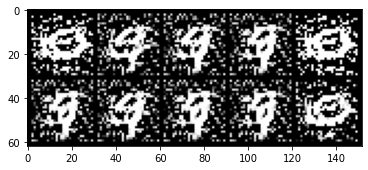

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


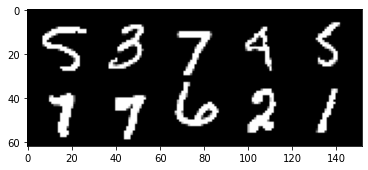

Epoch 90: 100%|██████████| 860/860 [00:45<00:00, 19.09it/s, loss=28.4, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 90:
disc_loss_step: 0.2659
gen_loss_epoch: 21.0946
disc_loss_epoch: 0.0124
gen_loss: 60.8379
disc_loss: 0.2659


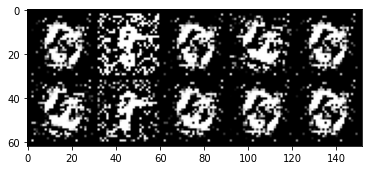

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


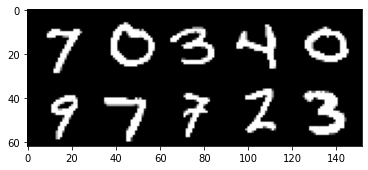

Epoch 91: 100%|██████████| 860/860 [00:45<00:00, 18.72it/s, loss=6.16, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 91:
disc_loss_step: 0.0003
gen_loss_epoch: 16.9671
disc_loss_epoch: 0.0402
gen_loss: 14.1468
disc_loss: 0.0003


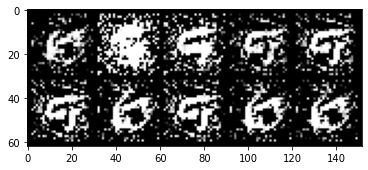

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


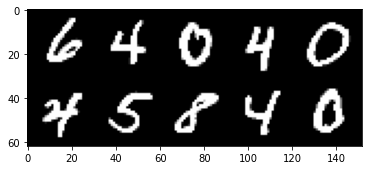

Epoch 92: 100%|██████████| 860/860 [00:47<00:00, 18.27it/s, loss=4.08, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 92:
disc_loss_step: 0.0001
gen_loss_epoch: 9.1530
disc_loss_epoch: 0.0039
gen_loss: 9.2725
disc_loss: 0.0001


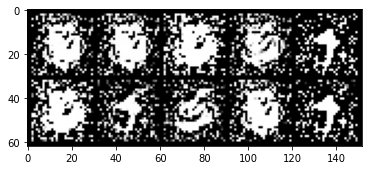

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


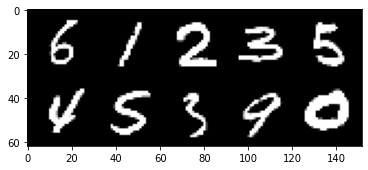

Epoch 93: 100%|██████████| 860/860 [00:42<00:00, 20.34it/s, loss=4.83, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 93:
disc_loss_step: 0.0006
gen_loss_epoch: 9.9831
disc_loss_epoch: 0.0015
gen_loss: 8.1424
disc_loss: 0.0006


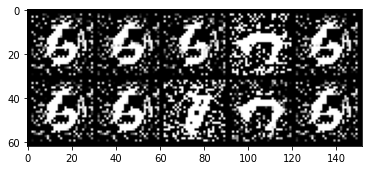

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


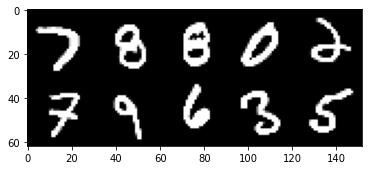

Epoch 94: 100%|██████████| 860/860 [00:48<00:00, 17.88it/s, loss=3.85, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 94:
disc_loss_step: 0.0005
gen_loss_epoch: 19.3120
disc_loss_epoch: 0.0460
gen_loss: 8.2885
disc_loss: 0.0005


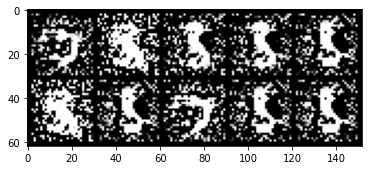

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


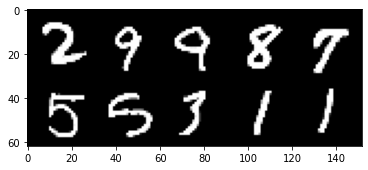

Epoch 95: 100%|██████████| 860/860 [00:44<00:00, 19.15it/s, loss=4.49, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 95:
disc_loss_step: 0.0002
gen_loss_epoch: 8.5870
disc_loss_epoch: 0.0026
gen_loss: 9.0841
disc_loss: 0.0002


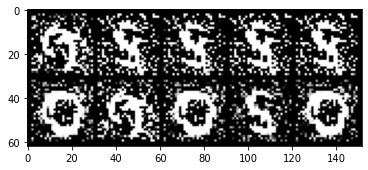

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


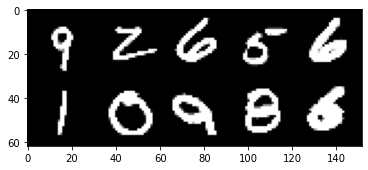

Epoch 96: 100%|██████████| 860/860 [00:47<00:00, 18.13it/s, loss=4.55, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 96:
disc_loss_step: 0.0001
gen_loss_epoch: 10.5352
disc_loss_epoch: 0.0025
gen_loss: 9.1176
disc_loss: 0.0001


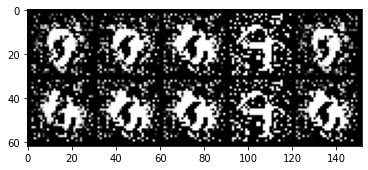

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


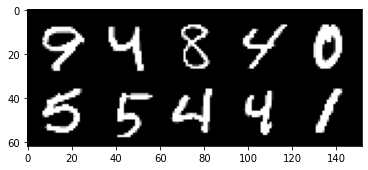

Epoch 97: 100%|██████████| 860/860 [00:46<00:00, 18.34it/s, loss=6.25, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 97:
disc_loss_step: 0.0013
gen_loss_epoch: 14.5803
disc_loss_epoch: 0.0036
gen_loss: 10.8807
disc_loss: 0.0013


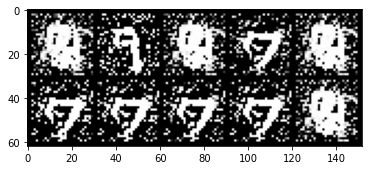

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


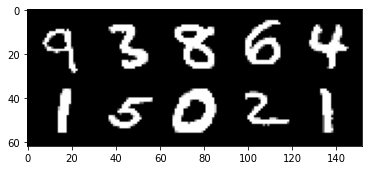

Epoch 98: 100%|██████████| 860/860 [00:45<00:00, 18.75it/s, loss=4.46, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 98:
disc_loss_step: 0.0007
gen_loss_epoch: 20.1982
disc_loss_epoch: 0.0268
gen_loss: 9.6768
disc_loss: 0.0007


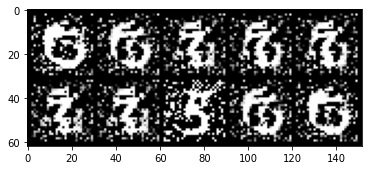

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


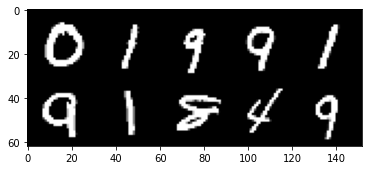

Epoch 99: 100%|██████████| 860/860 [00:43<00:00, 19.92it/s, loss=8.74, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 99:
disc_loss_step: 0.0001
gen_loss_epoch: 14.6171
disc_loss_epoch: 0.0071
gen_loss: 16.2550
disc_loss: 0.0001


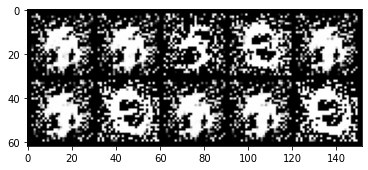

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


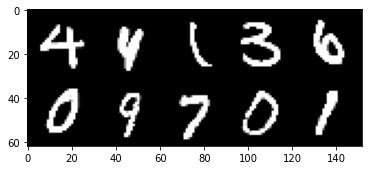

Epoch 100: 100%|██████████| 860/860 [00:41<00:00, 20.66it/s, loss=13.5, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 100:
disc_loss_step: 0.0000
gen_loss_epoch: 14.2555
disc_loss_epoch: 0.0030
gen_loss: 29.2475
disc_loss: 0.0000


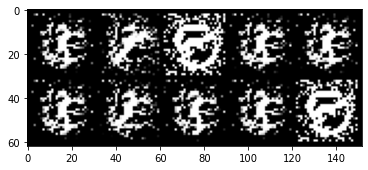

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


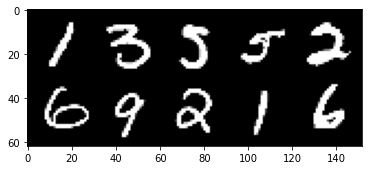

Epoch 101: 100%|██████████| 860/860 [00:42<00:00, 20.43it/s, loss=6.74, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 101:
disc_loss_step: 0.0069
gen_loss_epoch: 22.1656
disc_loss_epoch: 0.0309
gen_loss: 14.1263
disc_loss: 0.0069


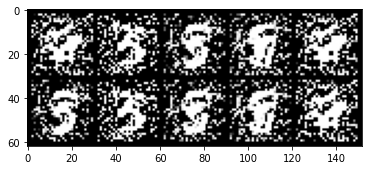

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


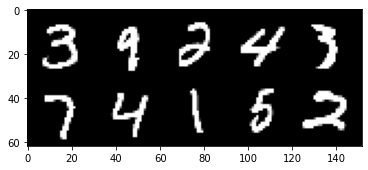

Epoch 102: 100%|██████████| 860/860 [00:43<00:00, 19.75it/s, loss=4.2, v_num=191] 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 102:
disc_loss_step: 0.0002
gen_loss_epoch: 16.1738
disc_loss_epoch: 0.0123
gen_loss: 9.8776
disc_loss: 0.0002


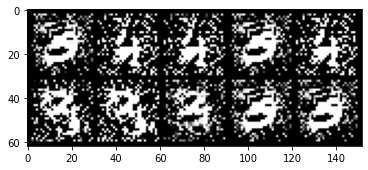

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


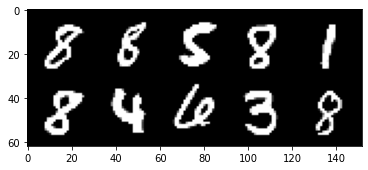

Epoch 103: 100%|██████████| 860/860 [00:37<00:00, 23.18it/s, loss=15.9, v_num=191]
Epoch 103:
disc_loss_step: 0.0007
gen_loss_epoch: 11.2989
disc_loss_epoch: 0.0046
gen_loss: 23.1612
disc_loss: 0.0007


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


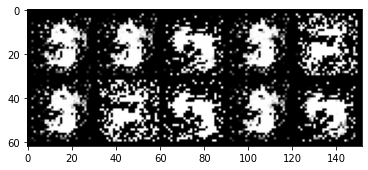

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


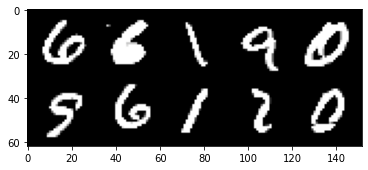

Epoch 104: 100%|██████████| 860/860 [00:41<00:00, 20.61it/s, loss=14.5, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 104:
disc_loss_step: 0.0000
gen_loss_epoch: 17.7475
disc_loss_epoch: 0.0178
gen_loss: 20.1728
disc_loss: 0.0000


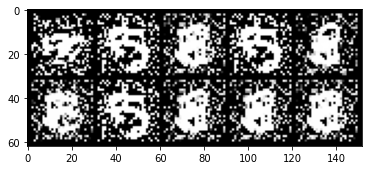

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


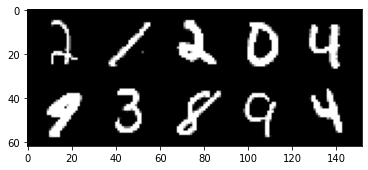

Epoch 105: 100%|██████████| 860/860 [00:41<00:00, 20.93it/s, loss=5.04, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 105:
disc_loss_step: 0.0001
gen_loss_epoch: 12.0200
disc_loss_epoch: 0.0049
gen_loss: 10.7024
disc_loss: 0.0001


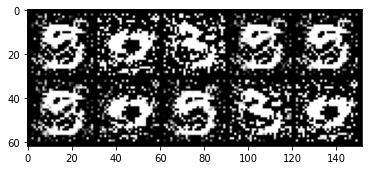

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


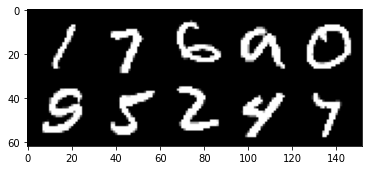

Epoch 106: 100%|██████████| 860/860 [00:38<00:00, 22.41it/s, loss=5.87, v_num=191]
Epoch 106:
disc_loss_step: 0.0001
gen_loss_epoch: 20.1474
disc_loss_epoch: 0.0083
gen_loss: 12.9716
disc_loss: 0.0001


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


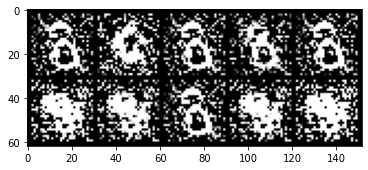

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


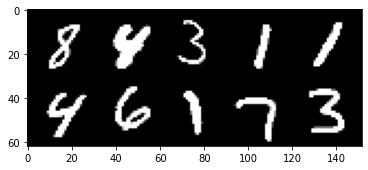

Epoch 107: 100%|██████████| 860/860 [00:41<00:00, 20.88it/s, loss=20.1, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 107:
disc_loss_step: 0.0000
gen_loss_epoch: 16.9204
disc_loss_epoch: 0.0039
gen_loss: 32.9350
disc_loss: 0.0000


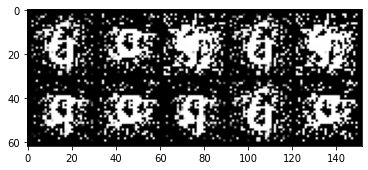

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


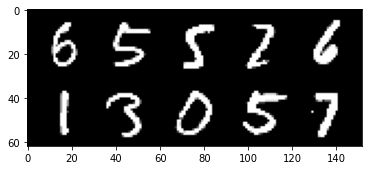

Epoch 108: 100%|██████████| 860/860 [00:40<00:00, 21.15it/s, loss=7.25, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 108:
disc_loss_step: 0.0007
gen_loss_epoch: 23.7124
disc_loss_epoch: 0.0507
gen_loss: 15.0008
disc_loss: 0.0007


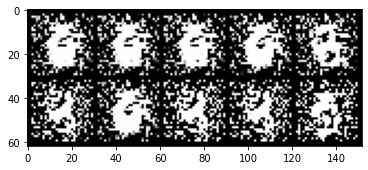

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


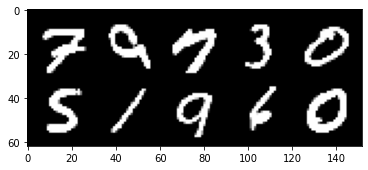

Epoch 109: 100%|██████████| 860/860 [00:41<00:00, 20.63it/s, loss=4.68, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 109:
disc_loss_step: 0.0002
gen_loss_epoch: 11.1596
disc_loss_epoch: 0.0053
gen_loss: 10.6502
disc_loss: 0.0002


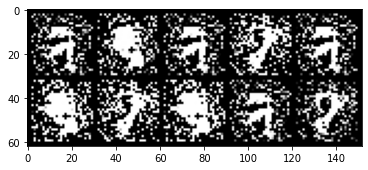

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


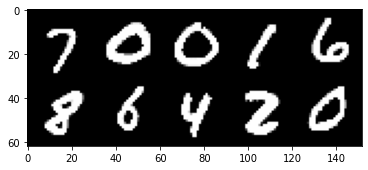

Epoch 110: 100%|██████████| 860/860 [00:40<00:00, 21.17it/s, loss=4.06, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 110:
disc_loss_step: 0.0005
gen_loss_epoch: 10.2481
disc_loss_epoch: 0.0022
gen_loss: 7.7591
disc_loss: 0.0005


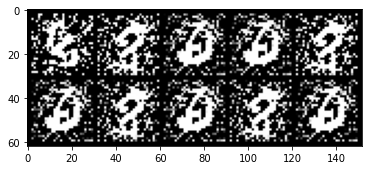

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


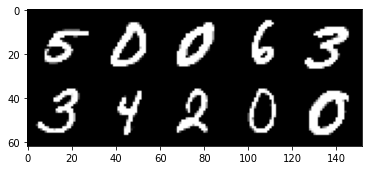

Epoch 111: 100%|██████████| 860/860 [00:42<00:00, 20.30it/s, loss=31.7, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 111:
disc_loss_step: 0.0000
gen_loss_epoch: 22.7633
disc_loss_epoch: 0.0252
gen_loss: 35.6555
disc_loss: 0.0000


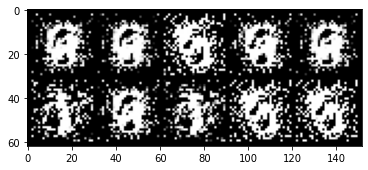

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


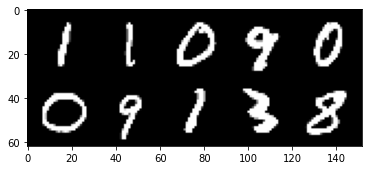

Epoch 112: 100%|██████████| 860/860 [00:43<00:00, 19.85it/s, loss=43, v_num=191]  

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 112:
disc_loss_step: 0.0000
gen_loss_epoch: 18.1978
disc_loss_epoch: 0.0185
gen_loss: 45.8826
disc_loss: 0.0000


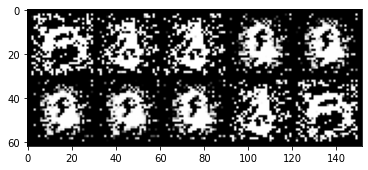

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


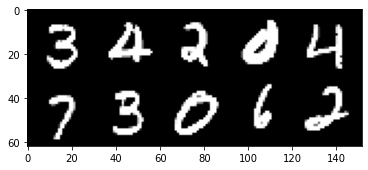

Epoch 113: 100%|██████████| 860/860 [00:42<00:00, 20.33it/s, loss=4.27, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 113:
disc_loss_step: 0.0001
gen_loss_epoch: 13.6659
disc_loss_epoch: 0.0083
gen_loss: 8.6156
disc_loss: 0.0001


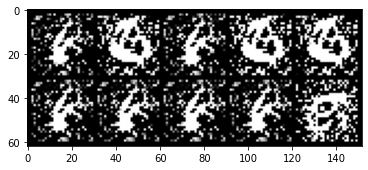

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


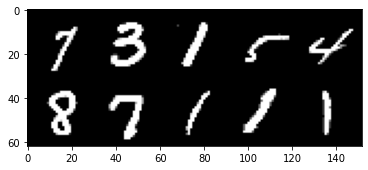

Epoch 114: 100%|██████████| 860/860 [00:41<00:00, 20.84it/s, loss=5.75, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 114:
disc_loss_step: 0.0001
gen_loss_epoch: 11.7198
disc_loss_epoch: 0.0028
gen_loss: 10.7804
disc_loss: 0.0001


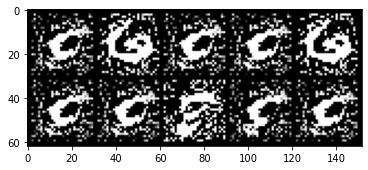

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


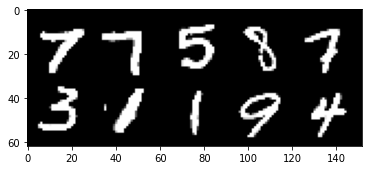

Epoch 115: 100%|██████████| 860/860 [00:41<00:00, 20.84it/s, loss=4.95, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 115:
disc_loss_step: 0.0002
gen_loss_epoch: 14.0874
disc_loss_epoch: 0.0027
gen_loss: 10.1940
disc_loss: 0.0002


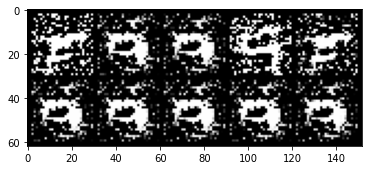

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


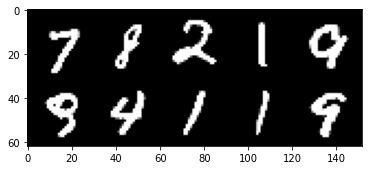

Epoch 116: 100%|██████████| 860/860 [00:43<00:00, 19.98it/s, loss=11.5, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 116:
disc_loss_step: 0.0000
gen_loss_epoch: 23.0782
disc_loss_epoch: 0.0434
gen_loss: 17.7440
disc_loss: 0.0000


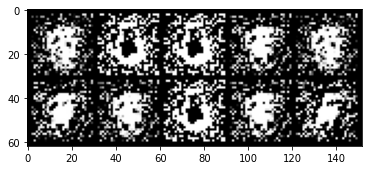

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


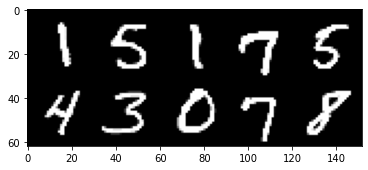

Epoch 117: 100%|██████████| 860/860 [00:40<00:00, 21.31it/s, loss=4.65, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 117:
disc_loss_step: 0.0001
gen_loss_epoch: 10.3513
disc_loss_epoch: 0.0061
gen_loss: 10.5931
disc_loss: 0.0001


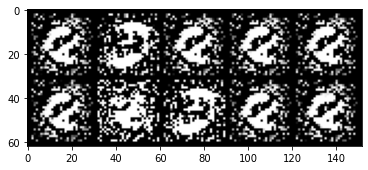

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


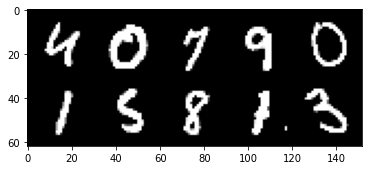

Epoch 118: 100%|██████████| 860/860 [00:36<00:00, 23.59it/s, loss=4.63, v_num=191]
Epoch 118:
disc_loss_step: 0.1181
gen_loss_epoch: 10.7428
disc_loss_epoch: 0.0022
gen_loss: 11.6414
disc_loss: 0.1181


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


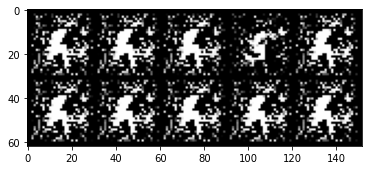

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


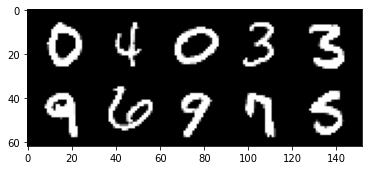

Epoch 119: 100%|██████████| 860/860 [00:40<00:00, 21.19it/s, loss=4.73, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 119:
disc_loss_step: 0.0002
gen_loss_epoch: 13.3528
disc_loss_epoch: 0.0025
gen_loss: 9.2010
disc_loss: 0.0002


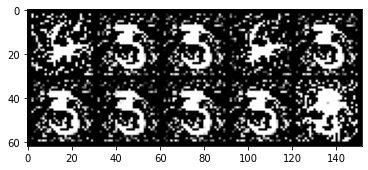

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


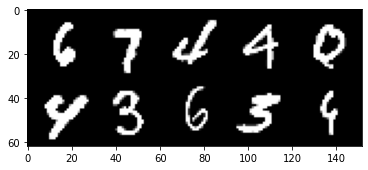

Epoch 120: 100%|██████████| 860/860 [00:45<00:00, 18.74it/s, loss=10.5, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 120:
disc_loss_step: 0.0011
gen_loss_epoch: 19.1660
disc_loss_epoch: 0.0902
gen_loss: 15.6763
disc_loss: 0.0011


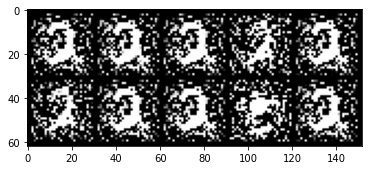

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


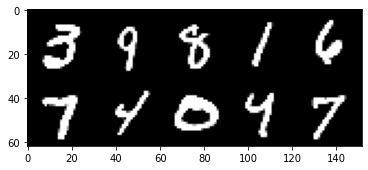

Epoch 121: 100%|██████████| 860/860 [00:45<00:00, 18.96it/s, loss=8.86, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 121:
disc_loss_step: 0.0000
gen_loss_epoch: 11.6397
disc_loss_epoch: 0.0046
gen_loss: 14.6542
disc_loss: 0.0000


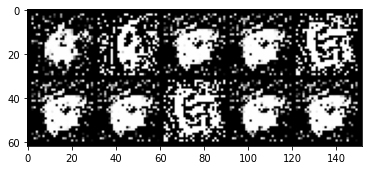

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


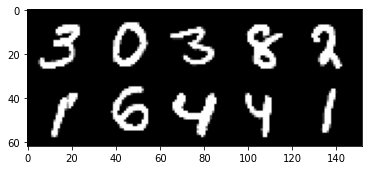

Epoch 122: 100%|██████████| 860/860 [00:44<00:00, 19.51it/s, loss=6.98, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 122:
disc_loss_step: 0.0001
gen_loss_epoch: 18.6985
disc_loss_epoch: 0.0081
gen_loss: 11.7428
disc_loss: 0.0001


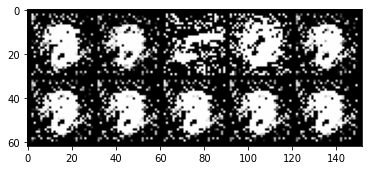

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


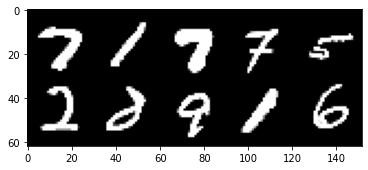

Epoch 123: 100%|██████████| 860/860 [00:43<00:00, 19.56it/s, loss=15.8, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 123:
disc_loss_step: 0.0001
gen_loss_epoch: 15.2037
disc_loss_epoch: 0.0068
gen_loss: 28.5091
disc_loss: 0.0001


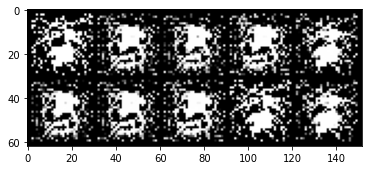

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


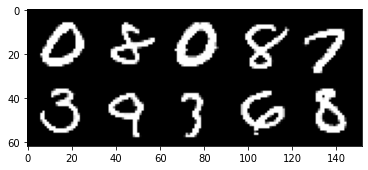

Epoch 124: 100%|██████████| 860/860 [00:41<00:00, 20.74it/s, loss=7.82, v_num=191]
Epoch 124:
disc_loss_step: 0.0000
gen_loss_epoch: 22.7277
disc_loss_epoch: 0.0101
gen_loss: 13.5866
disc_loss: 0.0000


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


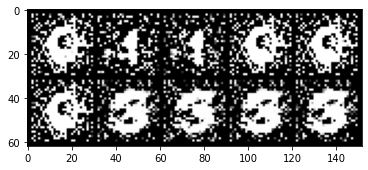

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


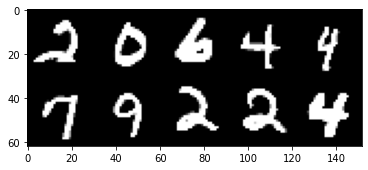

Epoch 125: 100%|██████████| 860/860 [00:41<00:00, 20.49it/s, loss=6.84, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 125:
disc_loss_step: 0.0000
gen_loss_epoch: 14.7817
disc_loss_epoch: 0.0029
gen_loss: 16.3185
disc_loss: 0.0000


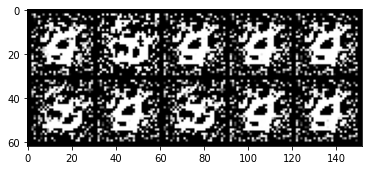

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


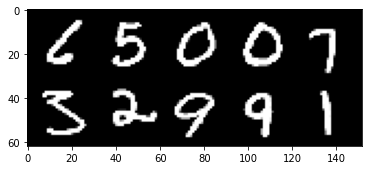

Epoch 126: 100%|██████████| 860/860 [00:43<00:00, 19.67it/s, loss=18.2, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 126:
disc_loss_step: 0.0000
gen_loss_epoch: 18.4647
disc_loss_epoch: 0.0031
gen_loss: 34.2327
disc_loss: 0.0000


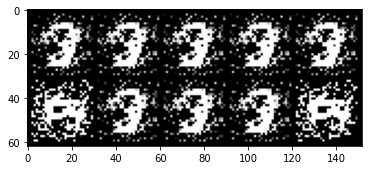

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


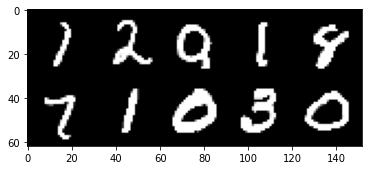

Epoch 127: 100%|██████████| 860/860 [00:44<00:00, 19.42it/s, loss=15.1, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 127:
disc_loss_step: 0.0000
gen_loss_epoch: 23.0773
disc_loss_epoch: 0.0567
gen_loss: 24.1490
disc_loss: 0.0000


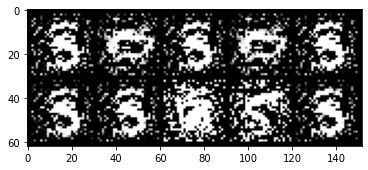

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


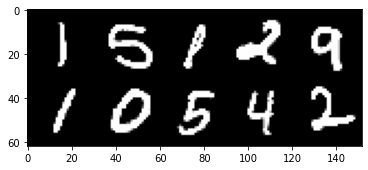

Epoch 128: 100%|██████████| 860/860 [00:42<00:00, 20.23it/s, loss=12.7, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 128:
disc_loss_step: 0.0000
gen_loss_epoch: 12.8059
disc_loss_epoch: 0.0064
gen_loss: 24.3888
disc_loss: 0.0000


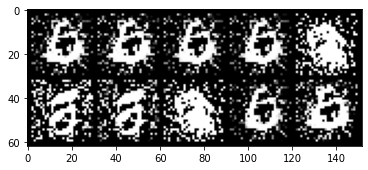

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


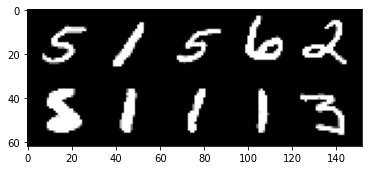

Epoch 129: 100%|██████████| 860/860 [00:40<00:00, 21.09it/s, loss=9.83, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 129:
disc_loss_step: 0.0004
gen_loss_epoch: 16.5234
disc_loss_epoch: 0.0048
gen_loss: 15.9409
disc_loss: 0.0004


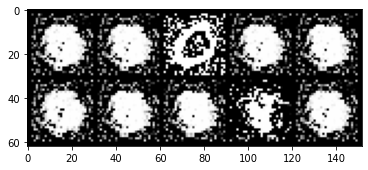

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


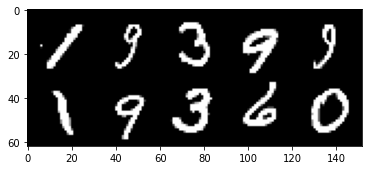

Epoch 130: 100%|██████████| 860/860 [00:42<00:00, 20.19it/s, loss=12.9, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 130:
disc_loss_step: 0.0000
gen_loss_epoch: 16.8545
disc_loss_epoch: 0.0032
gen_loss: 24.2380
disc_loss: 0.0000


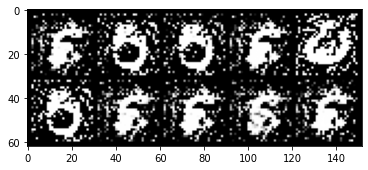

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


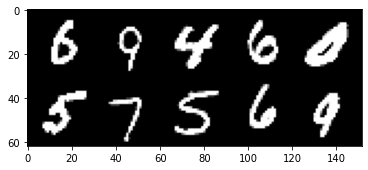

Epoch 131: 100%|██████████| 860/860 [00:41<00:00, 20.74it/s, loss=4.43, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 131:
disc_loss_step: 0.0001
gen_loss_epoch: 23.8052
disc_loss_epoch: 0.0451
gen_loss: 10.9095
disc_loss: 0.0001


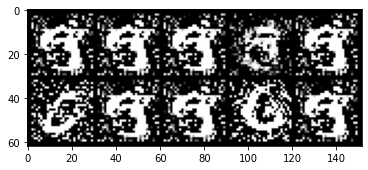

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


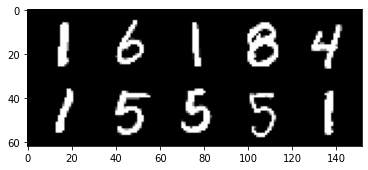

Epoch 132: 100%|██████████| 860/860 [00:40<00:00, 21.09it/s, loss=4.73, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 132:
disc_loss_step: 0.0002
gen_loss_epoch: 12.8460
disc_loss_epoch: 0.0040
gen_loss: 9.4452
disc_loss: 0.0002


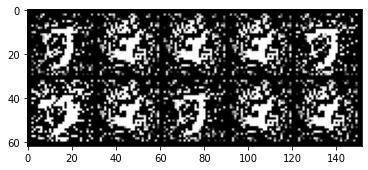

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


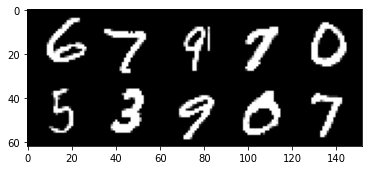

Epoch 133: 100%|██████████| 860/860 [00:35<00:00, 24.31it/s, loss=8.27, v_num=191]
Epoch 133:
disc_loss_step: 0.0000
gen_loss_epoch: 17.9350
disc_loss_epoch: 0.0050
gen_loss: 15.5882
disc_loss: 0.0000


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


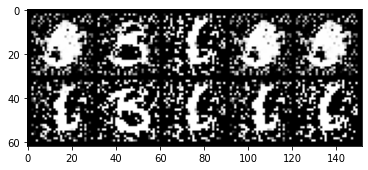

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


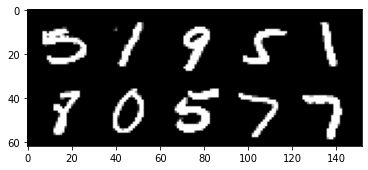

Epoch 134: 100%|██████████| 860/860 [00:40<00:00, 21.05it/s, loss=6.41, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 134:
disc_loss_step: 0.0000
gen_loss_epoch: 16.4591
disc_loss_epoch: 0.0046
gen_loss: 12.1844
disc_loss: 0.0000


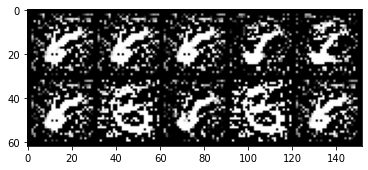

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


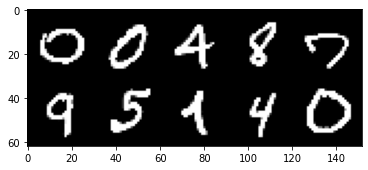

Epoch 135: 100%|██████████| 860/860 [00:43<00:00, 19.97it/s, loss=7.33, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 135:
disc_loss_step: 0.0000
gen_loss_epoch: 18.8492
disc_loss_epoch: 0.0040
gen_loss: 13.1270
disc_loss: 0.0000


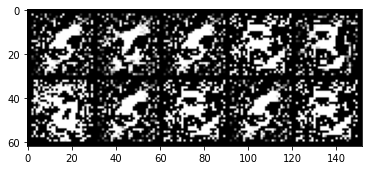

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


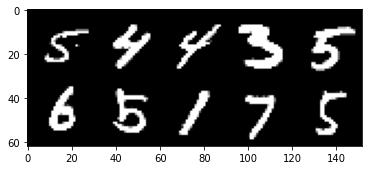

Epoch 136: 100%|██████████| 860/860 [00:44<00:00, 19.32it/s, loss=5.61, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 136:
disc_loss_step: 0.0001
gen_loss_epoch: 19.3840
disc_loss_epoch: 0.0339
gen_loss: 12.3502
disc_loss: 0.0001


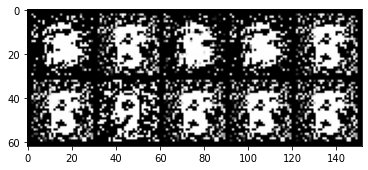

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


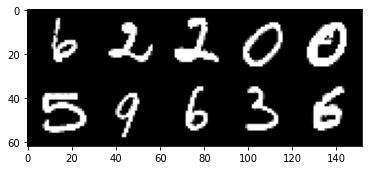

Epoch 137: 100%|██████████| 860/860 [00:41<00:00, 20.73it/s, loss=14.8, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 137:
disc_loss_step: 0.0001
gen_loss_epoch: 13.4860
disc_loss_epoch: 0.0023
gen_loss: 26.4780
disc_loss: 0.0001


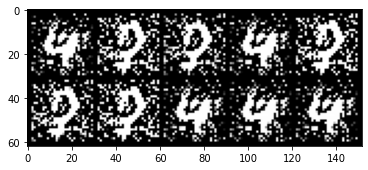

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


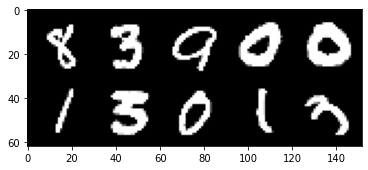

Epoch 138: 100%|██████████| 860/860 [00:41<00:00, 20.74it/s, loss=5.51, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 138:
disc_loss_step: 0.0004
gen_loss_epoch: 19.4232
disc_loss_epoch: 0.0153
gen_loss: 10.9300
disc_loss: 0.0004


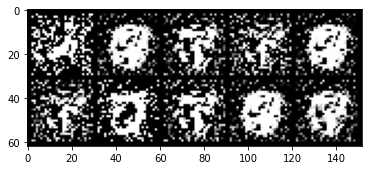

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


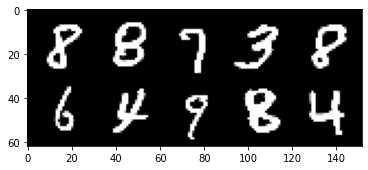

Epoch 139: 100%|██████████| 860/860 [00:41<00:00, 20.58it/s, loss=5.19, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 139:
disc_loss_step: 0.0002
gen_loss_epoch: 18.4256
disc_loss_epoch: 0.0107
gen_loss: 10.1688
disc_loss: 0.0002


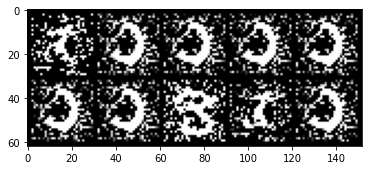

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


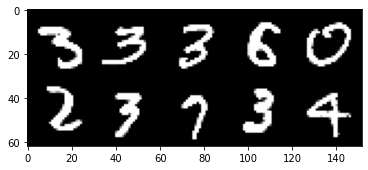

Epoch 140: 100%|██████████| 860/860 [00:41<00:00, 20.75it/s, loss=5.88, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 140:
disc_loss_step: 0.0001
gen_loss_epoch: 12.3420
disc_loss_epoch: 0.0027
gen_loss: 13.1738
disc_loss: 0.0001


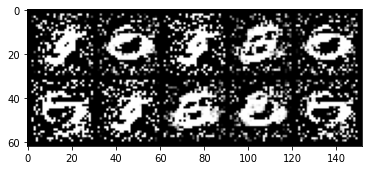

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


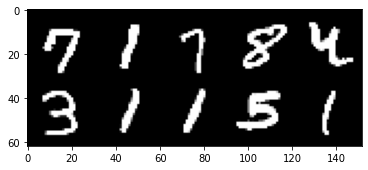

Epoch 141: 100%|██████████| 860/860 [00:42<00:00, 20.34it/s, loss=11.5, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 141:
disc_loss_step: 0.0000
gen_loss_epoch: 18.4700
disc_loss_epoch: 0.0028
gen_loss: 22.5742
disc_loss: 0.0000


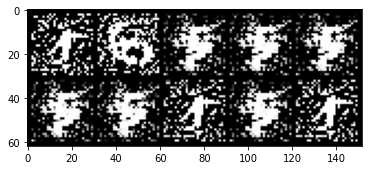

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


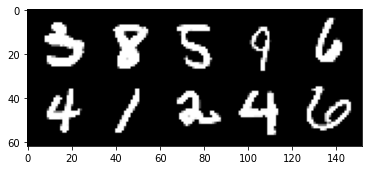

Epoch 142: 100%|██████████| 860/860 [00:42<00:00, 20.05it/s, loss=5.77, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 142:
disc_loss_step: 0.0001
gen_loss_epoch: 22.1117
disc_loss_epoch: 0.0248
gen_loss: 19.9393
disc_loss: 0.0001


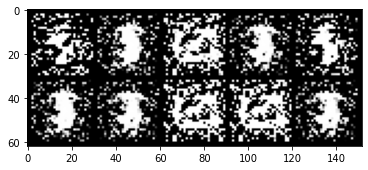

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


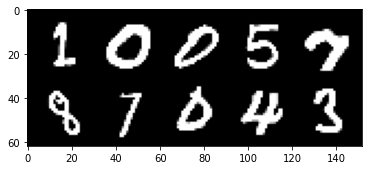

Epoch 143: 100%|██████████| 860/860 [00:40<00:00, 21.23it/s, loss=6.21, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 143:
disc_loss_step: 0.0002
gen_loss_epoch: 21.6495
disc_loss_epoch: 0.0162
gen_loss: 13.1267
disc_loss: 0.0002


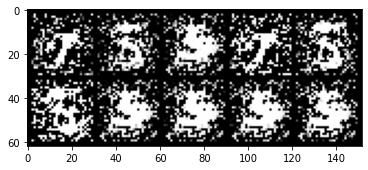

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


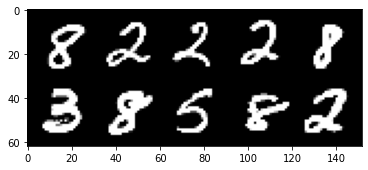

Epoch 144: 100%|██████████| 860/860 [00:41<00:00, 20.87it/s, loss=4.72, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 144:
disc_loss_step: 0.0001
gen_loss_epoch: 14.9546
disc_loss_epoch: 0.0037
gen_loss: 11.1129
disc_loss: 0.0001


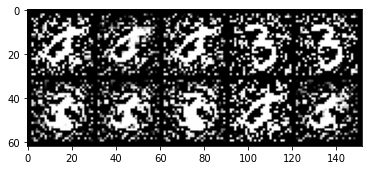

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


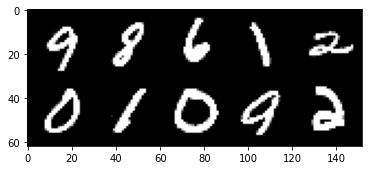

Epoch 145: 100%|██████████| 860/860 [00:40<00:00, 21.10it/s, loss=9, v_num=191]   

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 145:
disc_loss_step: 0.0000
gen_loss_epoch: 18.7863
disc_loss_epoch: 0.0418
gen_loss: 15.7942
disc_loss: 0.0000


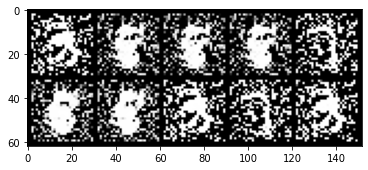

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


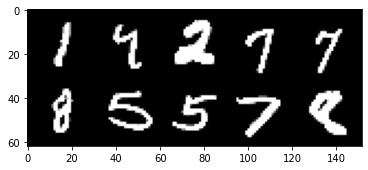

Epoch 146: 100%|██████████| 860/860 [00:40<00:00, 21.17it/s, loss=4.96, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 146:
disc_loss_step: 0.0001
gen_loss_epoch: 19.5172
disc_loss_epoch: 0.0151
gen_loss: 10.3203
disc_loss: 0.0001


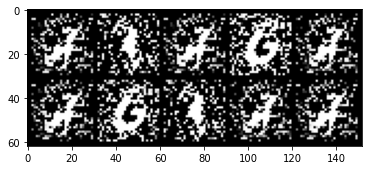

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


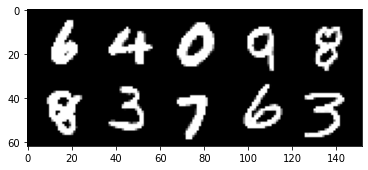

Epoch 147: 100%|██████████| 860/860 [00:41<00:00, 20.70it/s, loss=6.88, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 147:
disc_loss_step: 0.0000
gen_loss_epoch: 17.2854
disc_loss_epoch: 0.0111
gen_loss: 15.6899
disc_loss: 0.0000


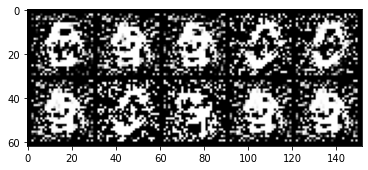

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


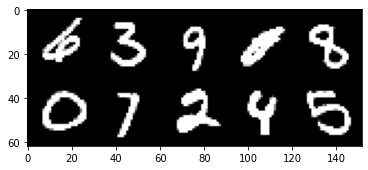

Epoch 148: 100%|██████████| 860/860 [00:40<00:00, 21.19it/s, loss=11.9, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 148:
disc_loss_step: 0.0000
gen_loss_epoch: 13.2251
disc_loss_epoch: 0.0027
gen_loss: 148.3455
disc_loss: 0.0000


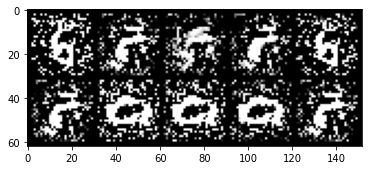

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


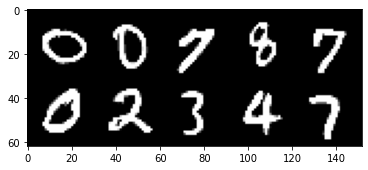

Epoch 149: 100%|██████████| 860/860 [00:41<00:00, 20.65it/s, loss=6.95, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 149:
disc_loss_step: 0.0000
gen_loss_epoch: 28.2334
disc_loss_epoch: 0.0324
gen_loss: 16.1053
disc_loss: 0.0000


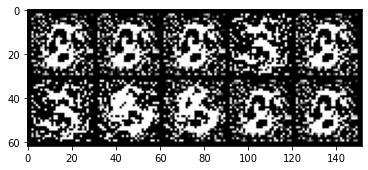

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


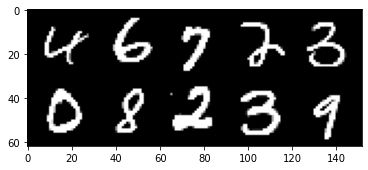

Epoch 150: 100%|██████████| 860/860 [00:44<00:00, 19.21it/s, loss=8.98, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 150:
disc_loss_step: 0.0041
gen_loss_epoch: 14.5375
disc_loss_epoch: 0.0076
gen_loss: 17.7531
disc_loss: 0.0041


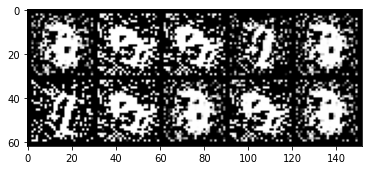

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


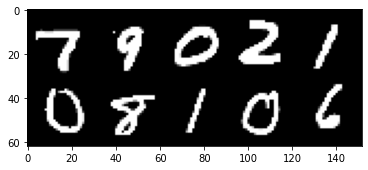

Epoch 151: 100%|██████████| 860/860 [00:41<00:00, 20.49it/s, loss=19.7, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 151:
disc_loss_step: 0.0000
gen_loss_epoch: 15.3309
disc_loss_epoch: 0.0034
gen_loss: 34.8849
disc_loss: 0.0000


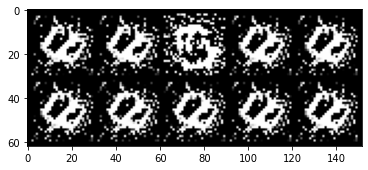

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


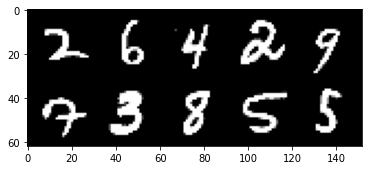

Epoch 152: 100%|██████████| 860/860 [00:43<00:00, 19.64it/s, loss=5.05, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 152:
disc_loss_step: 0.0002
gen_loss_epoch: 22.4036
disc_loss_epoch: 0.0368
gen_loss: 11.0720
disc_loss: 0.0002


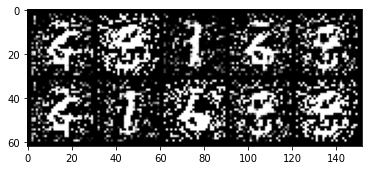

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


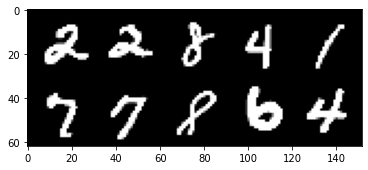

Epoch 153: 100%|██████████| 860/860 [00:42<00:00, 20.16it/s, loss=8.69, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 153:
disc_loss_step: 0.0002
gen_loss_epoch: 10.9341
disc_loss_epoch: 0.0030
gen_loss: 16.4625
disc_loss: 0.0002


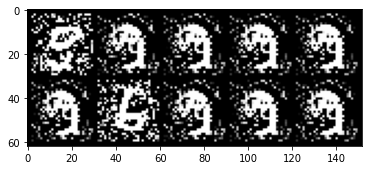

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


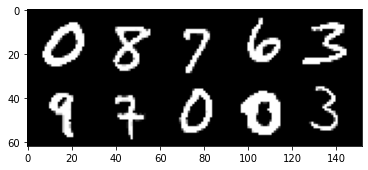

Epoch 154: 100%|██████████| 860/860 [00:42<00:00, 20.21it/s, loss=17.2, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 154:
disc_loss_step: 0.0000
gen_loss_epoch: 27.1038
disc_loss_epoch: 0.0278
gen_loss: 31.7237
disc_loss: 0.0000


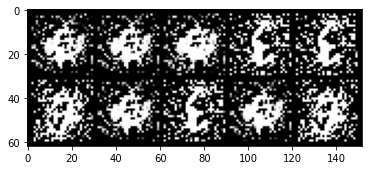

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


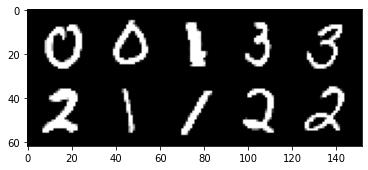

Epoch 155: 100%|██████████| 860/860 [00:42<00:00, 20.18it/s, loss=5.86, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 155:
disc_loss_step: 0.0004
gen_loss_epoch: 14.6875
disc_loss_epoch: 0.0048
gen_loss: 11.4953
disc_loss: 0.0004


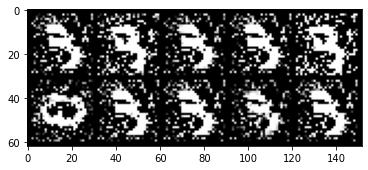

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


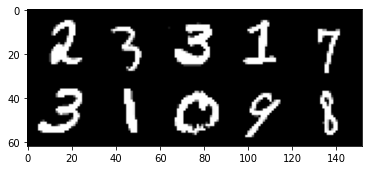

Epoch 156: 100%|██████████| 860/860 [00:40<00:00, 21.00it/s, loss=4.56, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 156:
disc_loss_step: 0.0003
gen_loss_epoch: 18.6756
disc_loss_epoch: 0.0070
gen_loss: 8.9610
disc_loss: 0.0003


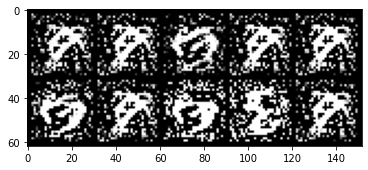

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


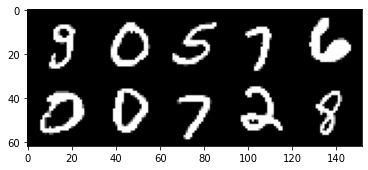

Epoch 157: 100%|██████████| 860/860 [00:43<00:00, 19.65it/s, loss=20.8, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 157:
disc_loss_step: 0.0000
gen_loss_epoch: 22.5332
disc_loss_epoch: 0.0106
gen_loss: 30.6835
disc_loss: 0.0000


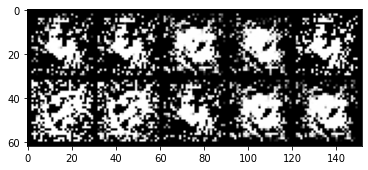

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


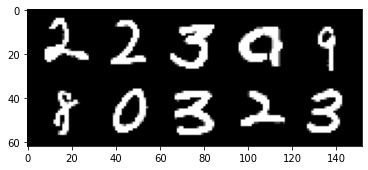

Epoch 158: 100%|██████████| 860/860 [00:42<00:00, 20.18it/s, loss=4.72, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 158:
disc_loss_step: 0.0001
gen_loss_epoch: 32.2612
disc_loss_epoch: 0.0192
gen_loss: 11.6800
disc_loss: 0.0001


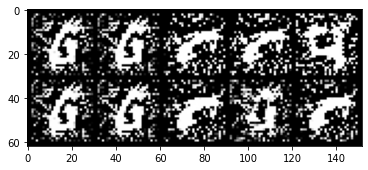

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


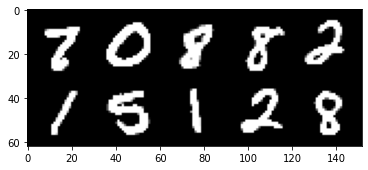

Epoch 159: 100%|██████████| 860/860 [00:40<00:00, 21.20it/s, loss=8.4, v_num=191] 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 159:
disc_loss_step: 0.0002
gen_loss_epoch: 15.8468
disc_loss_epoch: 0.0035
gen_loss: 16.7820
disc_loss: 0.0002


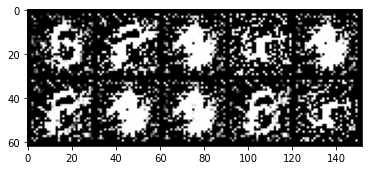

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


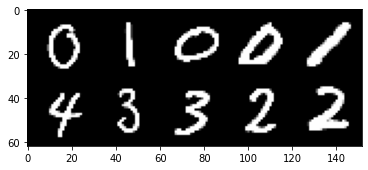

Epoch 160: 100%|██████████| 860/860 [00:41<00:00, 20.68it/s, loss=16, v_num=191]  

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 160:
disc_loss_step: 0.0000
gen_loss_epoch: 19.7118
disc_loss_epoch: 0.0031
gen_loss: 29.4282
disc_loss: 0.0000


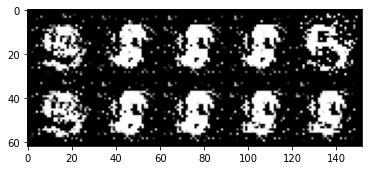

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


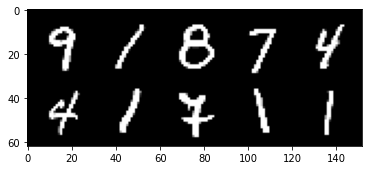

Epoch 161: 100%|██████████| 860/860 [00:42<00:00, 20.18it/s, loss=10.9, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 161:
disc_loss_step: 0.0000
gen_loss_epoch: 29.4919
disc_loss_epoch: 0.0328
gen_loss: 19.1955
disc_loss: 0.0000


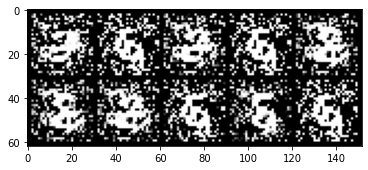

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


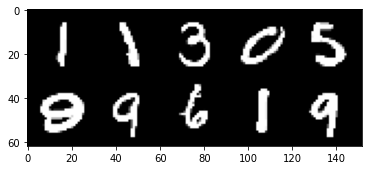

Epoch 162: 100%|██████████| 860/860 [00:41<00:00, 20.67it/s, loss=5.27, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 162:
disc_loss_step: 0.0007
gen_loss_epoch: 24.4121
disc_loss_epoch: 0.0079
gen_loss: 10.8191
disc_loss: 0.0007


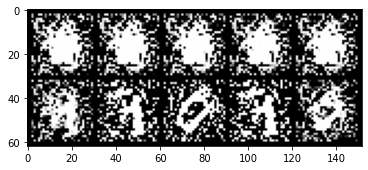

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


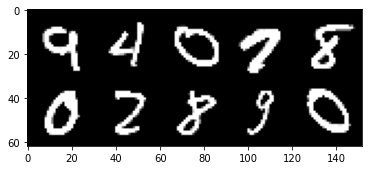

Epoch 163: 100%|██████████| 860/860 [00:41<00:00, 20.78it/s, loss=9.36, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 163:
disc_loss_step: 0.0000
gen_loss_epoch: 18.7887
disc_loss_epoch: 0.0041
gen_loss: 19.1169
disc_loss: 0.0000


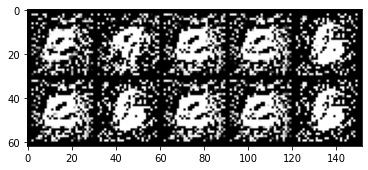

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


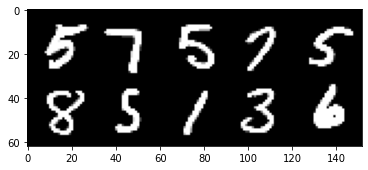

Epoch 164: 100%|██████████| 860/860 [00:40<00:00, 21.26it/s, loss=7.41, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 164:
disc_loss_step: 0.0000
gen_loss_epoch: 22.0596
disc_loss_epoch: 0.0052
gen_loss: 17.0313
disc_loss: 0.0000


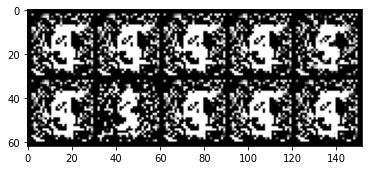

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


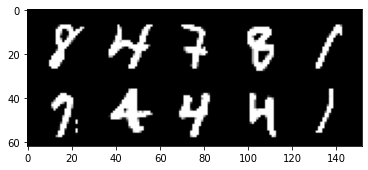

Epoch 165: 100%|██████████| 860/860 [00:41<00:00, 20.94it/s, loss=6.01, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 165:
disc_loss_step: 0.0001
gen_loss_epoch: 22.1244
disc_loss_epoch: 0.0028
gen_loss: 12.0334
disc_loss: 0.0001


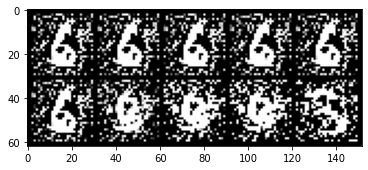

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


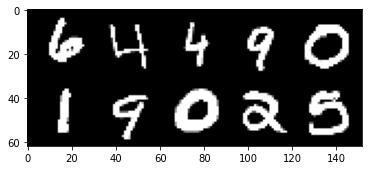

Epoch 166: 100%|██████████| 860/860 [00:46<00:00, 18.48it/s, loss=7.53, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 166:
disc_loss_step: 0.0004
gen_loss_epoch: 36.6048
disc_loss_epoch: 0.0706
gen_loss: 15.3041
disc_loss: 0.0004


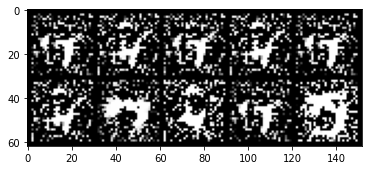

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


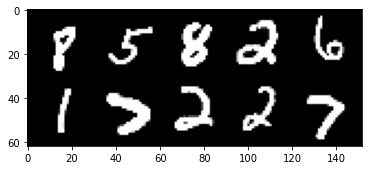

Epoch 167: 100%|██████████| 860/860 [00:40<00:00, 21.50it/s, loss=8.41, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 167:
disc_loss_step: 0.0003
gen_loss_epoch: 13.1777
disc_loss_epoch: 0.0053
gen_loss: 14.4709
disc_loss: 0.0003


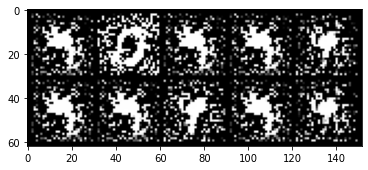

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


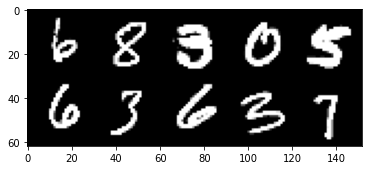

Epoch 168: 100%|██████████| 860/860 [00:38<00:00, 22.06it/s, loss=7.02, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 168:
disc_loss_step: 0.0004
gen_loss_epoch: 15.4257
disc_loss_epoch: 0.0034
gen_loss: 11.0635
disc_loss: 0.0004


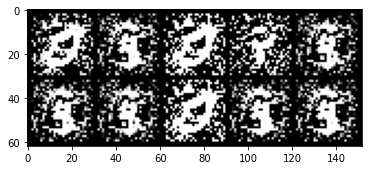

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


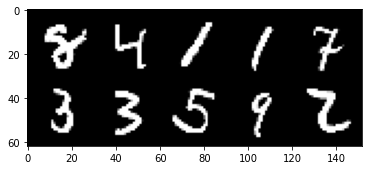

Epoch 169: 100%|██████████| 860/860 [00:47<00:00, 18.20it/s, loss=11.9, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 169:
disc_loss_step: 0.0000
gen_loss_epoch: 32.6123
disc_loss_epoch: 0.0351
gen_loss: 22.4832
disc_loss: 0.0000


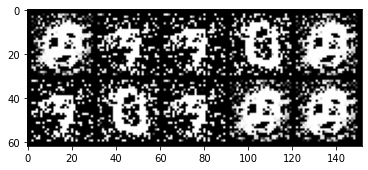

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


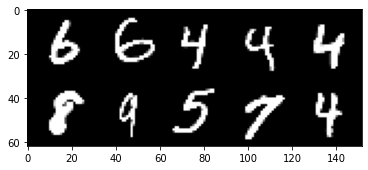

Epoch 170: 100%|██████████| 860/860 [00:46<00:00, 18.38it/s, loss=5.14, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 170:
disc_loss_step: 0.0000
gen_loss_epoch: 14.9113
disc_loss_epoch: 0.0044
gen_loss: 12.2963
disc_loss: 0.0000


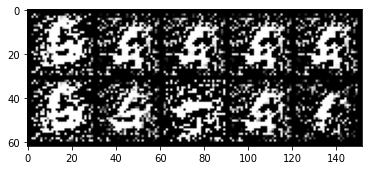

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


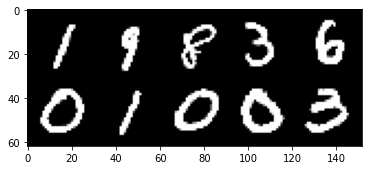

Epoch 171: 100%|██████████| 860/860 [00:45<00:00, 19.09it/s, loss=5.34, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 171:
disc_loss_step: 0.0000
gen_loss_epoch: 17.1890
disc_loss_epoch: 0.0040
gen_loss: 14.6507
disc_loss: 0.0000


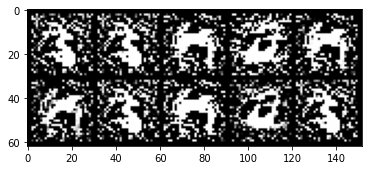

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


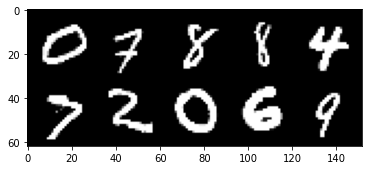

Epoch 172: 100%|██████████| 860/860 [00:44<00:00, 19.31it/s, loss=19.1, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 172:
disc_loss_step: 0.0001
gen_loss_epoch: 27.2602
disc_loss_epoch: 0.0243
gen_loss: 35.8303
disc_loss: 0.0001


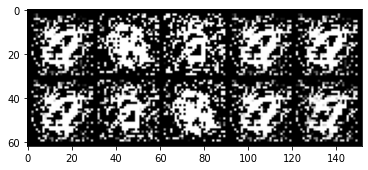

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


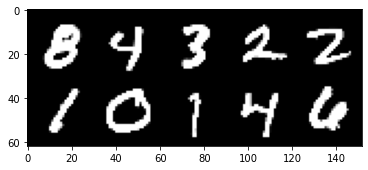

Epoch 173: 100%|██████████| 860/860 [00:44<00:00, 19.22it/s, loss=5, v_num=191]   

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 173:
disc_loss_step: 0.0001
gen_loss_epoch: 15.6447
disc_loss_epoch: 0.0026
gen_loss: 8.9846
disc_loss: 0.0001


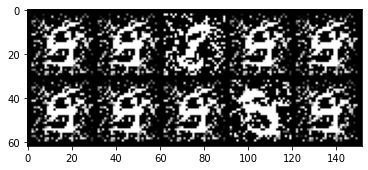

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


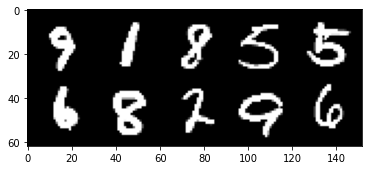

Epoch 174: 100%|██████████| 860/860 [00:47<00:00, 17.97it/s, loss=4.6, v_num=191] 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 174:
disc_loss_step: 0.0001
gen_loss_epoch: 24.1794
disc_loss_epoch: 0.0577
gen_loss: 10.7604
disc_loss: 0.0001


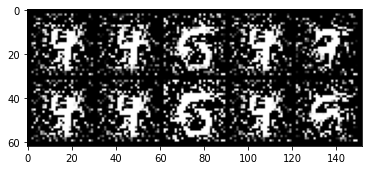

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


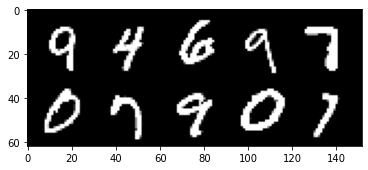

Epoch 175: 100%|██████████| 860/860 [00:44<00:00, 19.35it/s, loss=4.93, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 175:
disc_loss_step: 0.0001
gen_loss_epoch: 12.8908
disc_loss_epoch: 0.0035
gen_loss: 10.3181
disc_loss: 0.0001


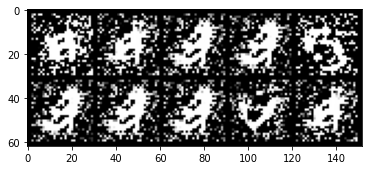

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


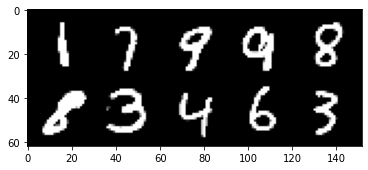

Epoch 176: 100%|██████████| 860/860 [00:45<00:00, 18.92it/s, loss=40.2, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 176:
disc_loss_step: 0.0044
gen_loss_epoch: 19.7653
disc_loss_epoch: 0.0304
gen_loss: 118.0805
disc_loss: 0.0044


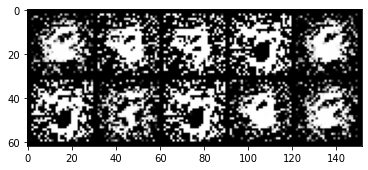

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


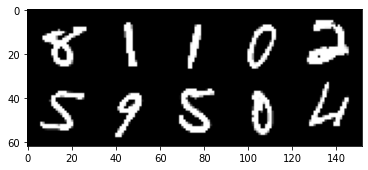

Epoch 177: 100%|██████████| 860/860 [00:44<00:00, 19.41it/s, loss=6.42, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 177:
disc_loss_step: 0.0002
gen_loss_epoch: 19.5164
disc_loss_epoch: 0.0064
gen_loss: 13.2721
disc_loss: 0.0002


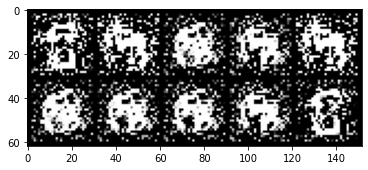

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


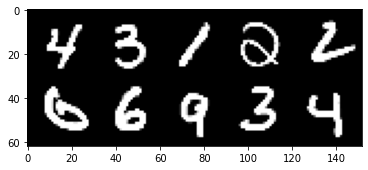

Epoch 178: 100%|██████████| 860/860 [00:43<00:00, 19.85it/s, loss=10.8, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 178:
disc_loss_step: 0.0000
gen_loss_epoch: 17.6833
disc_loss_epoch: 0.0052
gen_loss: 22.1538
disc_loss: 0.0000


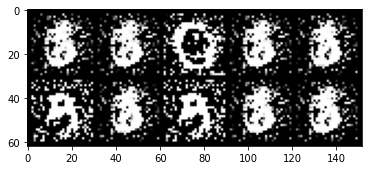

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


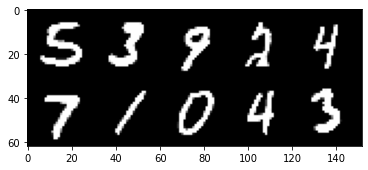

Epoch 179: 100%|██████████| 860/860 [00:46<00:00, 18.45it/s, loss=10.8, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 179:
disc_loss_step: 0.0000
gen_loss_epoch: 17.6269
disc_loss_epoch: 0.0115
gen_loss: 18.5102
disc_loss: 0.0000


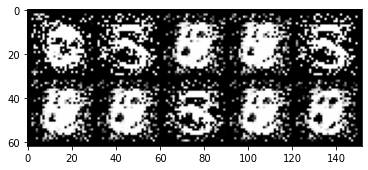

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


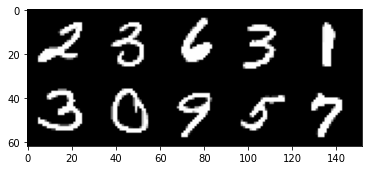

Epoch 180: 100%|██████████| 860/860 [00:43<00:00, 19.87it/s, loss=6.33, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 180:
disc_loss_step: 0.0000
gen_loss_epoch: 25.6561
disc_loss_epoch: 0.0143
gen_loss: 15.0960
disc_loss: 0.0000


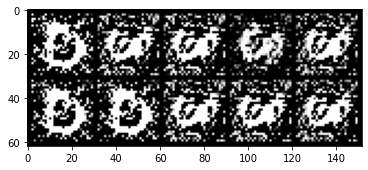

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


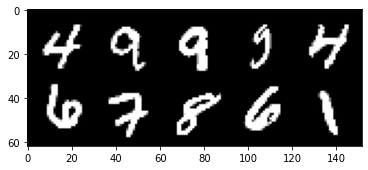

Epoch 181: 100%|██████████| 860/860 [00:38<00:00, 22.10it/s, loss=7.37, v_num=191]
Epoch 181:
disc_loss_step: 0.0000
gen_loss_epoch: 22.1076
disc_loss_epoch: 0.0034
gen_loss: 14.6830
disc_loss: 0.0000


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


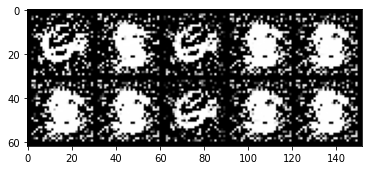

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


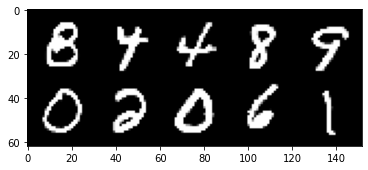

Epoch 182: 100%|██████████| 860/860 [00:47<00:00, 18.19it/s, loss=30.7, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 182:
disc_loss_step: 0.0000
gen_loss_epoch: 26.0699
disc_loss_epoch: 0.0503
gen_loss: 43.0664
disc_loss: 0.0000


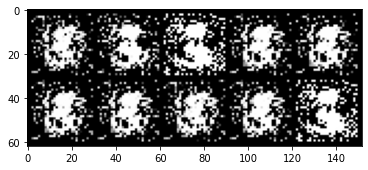

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


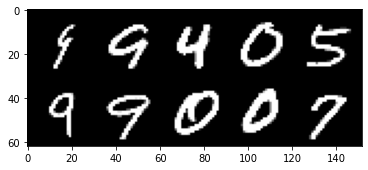

Epoch 183: 100%|██████████| 860/860 [00:43<00:00, 19.66it/s, loss=6.72, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 183:
disc_loss_step: 0.0001
gen_loss_epoch: 17.8845
disc_loss_epoch: 0.0078
gen_loss: 11.4011
disc_loss: 0.0001


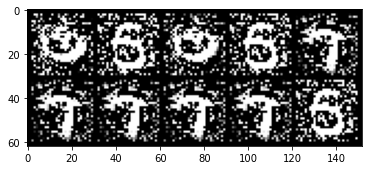

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


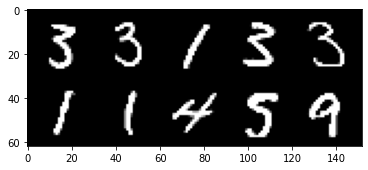

Epoch 184: 100%|██████████| 860/860 [00:43<00:00, 19.95it/s, loss=7.42, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 184:
disc_loss_step: 0.0002
gen_loss_epoch: 19.1369
disc_loss_epoch: 0.0037
gen_loss: 13.7380
disc_loss: 0.0002


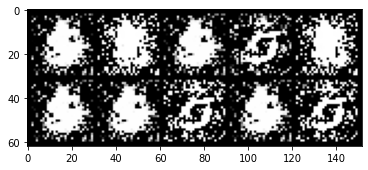

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


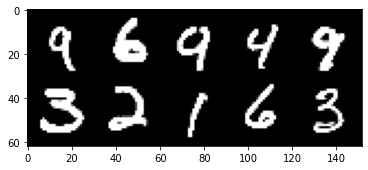

Epoch 185: 100%|██████████| 860/860 [00:43<00:00, 19.88it/s, loss=13.9, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 185:
disc_loss_step: 0.0000
gen_loss_epoch: 33.7431
disc_loss_epoch: 0.0206
gen_loss: 19.7021
disc_loss: 0.0000


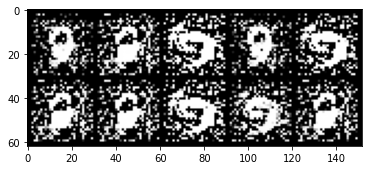

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


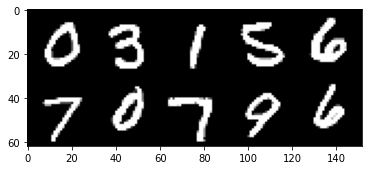

Epoch 186: 100%|██████████| 860/860 [00:48<00:00, 17.78it/s, loss=24.6, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 186:
disc_loss_step: 0.0002
gen_loss_epoch: 36.4646
disc_loss_epoch: 0.0237
gen_loss: 49.7579
disc_loss: 0.0002


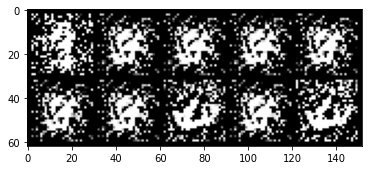

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


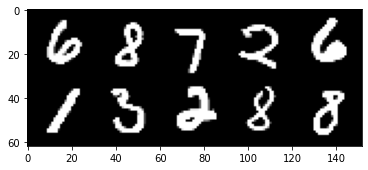

Epoch 187: 100%|██████████| 860/860 [00:42<00:00, 20.44it/s, loss=5.14, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 187:
disc_loss_step: 0.0007
gen_loss_epoch: 19.1473
disc_loss_epoch: 0.0039
gen_loss: 9.4913
disc_loss: 0.0007


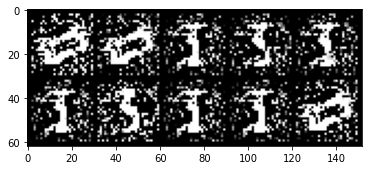

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


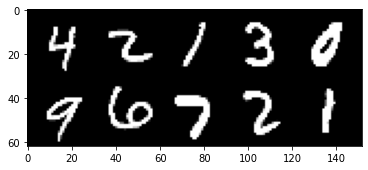

Epoch 188: 100%|██████████| 860/860 [00:44<00:00, 19.40it/s, loss=8.14, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 188:
disc_loss_step: 0.0000
gen_loss_epoch: 16.6362
disc_loss_epoch: 0.0028
gen_loss: 19.6394
disc_loss: 0.0000


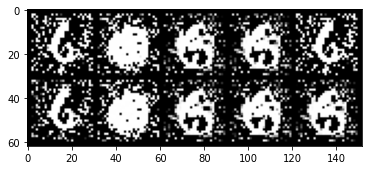

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


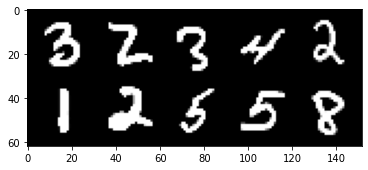

Epoch 189: 100%|██████████| 860/860 [00:46<00:00, 18.59it/s, loss=19.1, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 189:
disc_loss_step: 0.0000
gen_loss_epoch: 23.2664
disc_loss_epoch: 0.0031
gen_loss: 30.1657
disc_loss: 0.0000


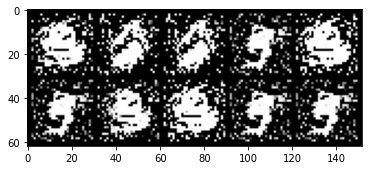

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


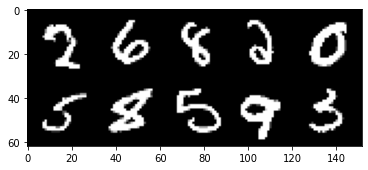

Epoch 190: 100%|██████████| 860/860 [00:47<00:00, 18.00it/s, loss=30.3, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 190:
disc_loss_step: 0.0000
gen_loss_epoch: 47.5140
disc_loss_epoch: 0.0445
gen_loss: 53.2676
disc_loss: 0.0000


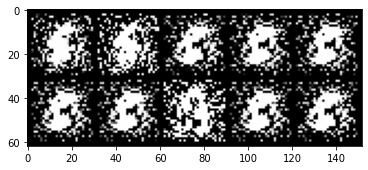

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


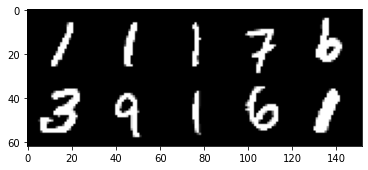

Epoch 191: 100%|██████████| 860/860 [00:40<00:00, 21.28it/s, loss=6.09, v_num=191]
Epoch 191:
disc_loss_step: 0.0016
gen_loss_epoch: 43.2622
disc_loss_epoch: 0.0208
gen_loss: 10.3476
disc_loss: 0.0016


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


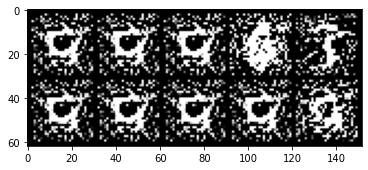

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


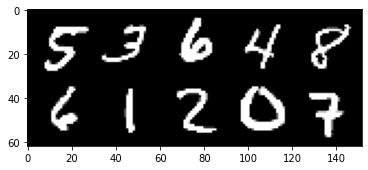

Epoch 192: 100%|██████████| 860/860 [00:41<00:00, 20.94it/s, loss=12.6, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 192:
disc_loss_step: 0.0000
gen_loss_epoch: 23.3332
disc_loss_epoch: 0.0108
gen_loss: 26.1631
disc_loss: 0.0000


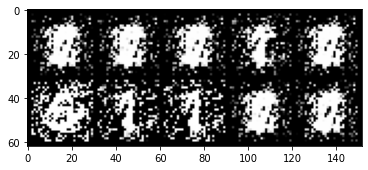

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


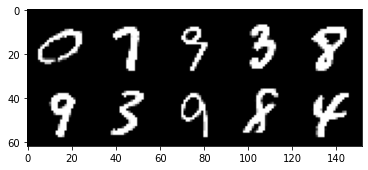

Epoch 193: 100%|██████████| 860/860 [00:41<00:00, 20.62it/s, loss=10.8, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 193:
disc_loss_step: 0.0001
gen_loss_epoch: 27.7910
disc_loss_epoch: 0.0115
gen_loss: 21.3973
disc_loss: 0.0001


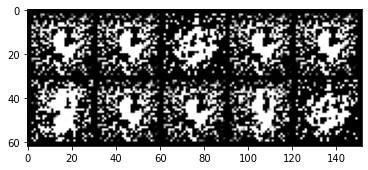

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


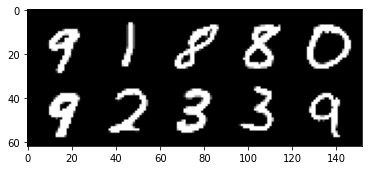

Epoch 194: 100%|██████████| 860/860 [00:43<00:00, 19.94it/s, loss=5.43, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 194:
disc_loss_step: 0.0001
gen_loss_epoch: 30.2942
disc_loss_epoch: 0.0098
gen_loss: 10.8358
disc_loss: 0.0001


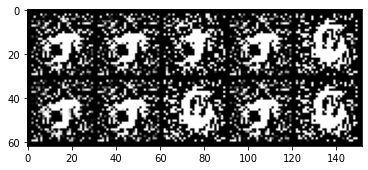

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


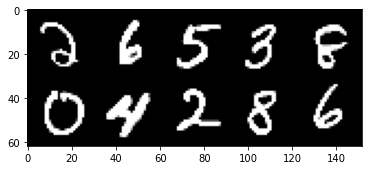

Epoch 195: 100%|██████████| 860/860 [00:44<00:00, 19.32it/s, loss=6.55, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 195:
disc_loss_step: 0.0000
gen_loss_epoch: 14.2268
disc_loss_epoch: 0.0010
gen_loss: 12.0115
disc_loss: 0.0000


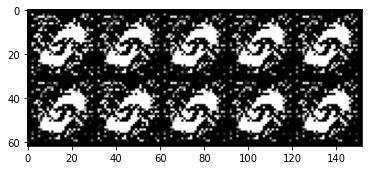

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


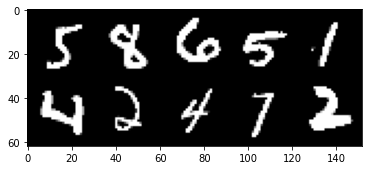

Epoch 196: 100%|██████████| 860/860 [00:44<00:00, 19.41it/s, loss=22.8, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 196:
disc_loss_step: 0.0000
gen_loss_epoch: 31.0430
disc_loss_epoch: 0.0035
gen_loss: 42.4861
disc_loss: 0.0000


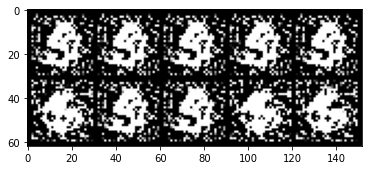

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


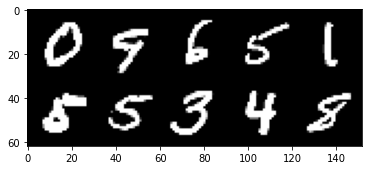

Epoch 197: 100%|██████████| 860/860 [00:41<00:00, 20.76it/s, loss=17.6, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 197:
disc_loss_step: 0.0000
gen_loss_epoch: 26.7276
disc_loss_epoch: 0.0019
gen_loss: 32.9862
disc_loss: 0.0000


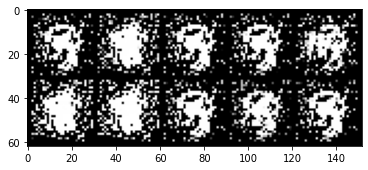

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


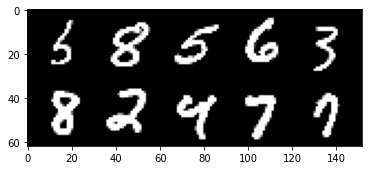

Epoch 198: 100%|██████████| 860/860 [00:41<00:00, 20.76it/s, loss=6.31, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 198:
disc_loss_step: 0.0000
gen_loss_epoch: 18.7183
disc_loss_epoch: 0.0005
gen_loss: 13.6772
disc_loss: 0.0000


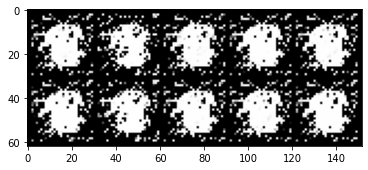

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


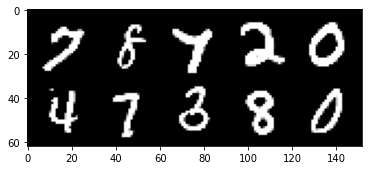

Epoch 199: 100%|██████████| 860/860 [00:44<00:00, 19.25it/s, loss=5.94, v_num=191]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).



Epoch 199:
disc_loss_step: 0.0011
gen_loss_epoch: 34.9162
disc_loss_epoch: 0.0857
gen_loss: 11.9284
disc_loss: 0.0011


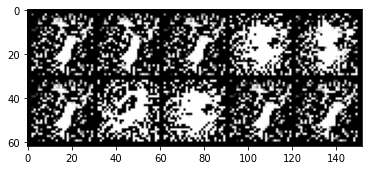

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


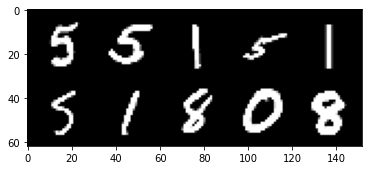

Epoch 199: 100%|██████████| 860/860 [00:45<00:00, 19.03it/s, loss=5.94, v_num=191]


1

In [8]:
data_module = MNISTDataModule(args)
model = MNISTGAN(args)
trainer = pl.Trainer(max_epochs=200, progress_bar_refresh_rate=20, callbacks=[MNISTCallbacks()])
trainer.fit(model, data_module)